# Subclustering of lateral ectoderm in Set2

In [1]:
#loading packages
library(Seurat)
library(ggplot2)
library(magrittr)
library(data.table)
library(Matrix)
library(dplyr)
library(tibble)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [2]:
seu_HQC <- readRDS(file = '../../data/seurat_object/Set2/seu_HQC2_Set2.obj')
seu_HQC

An object of class Seurat 
28364 features across 4897 samples within 2 assays 
Active assay: SCT (10860 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


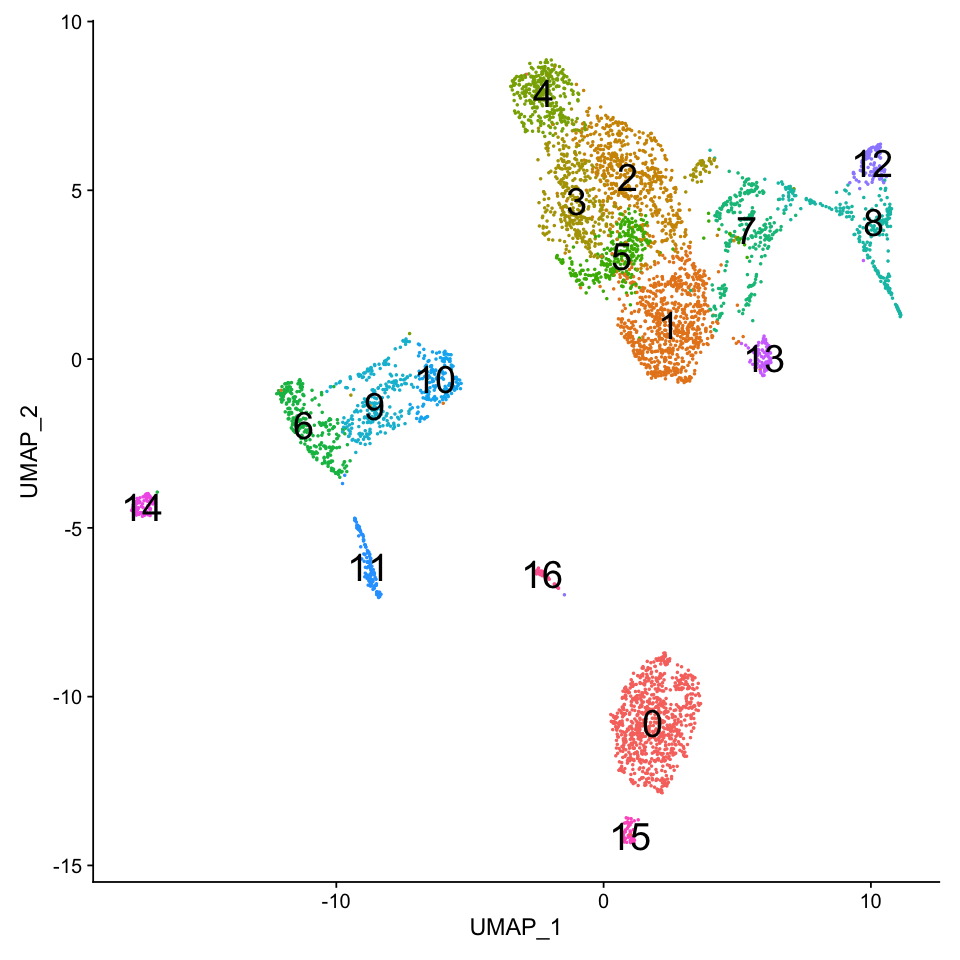

In [3]:
Idents(seu_HQC) <- 'seurat_clusters'
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu_HQC, reduction = 'umap', label = TRUE, label.size = 8) + NoLegend()

## Picking up target clusters

Saving 7 x 7 in image



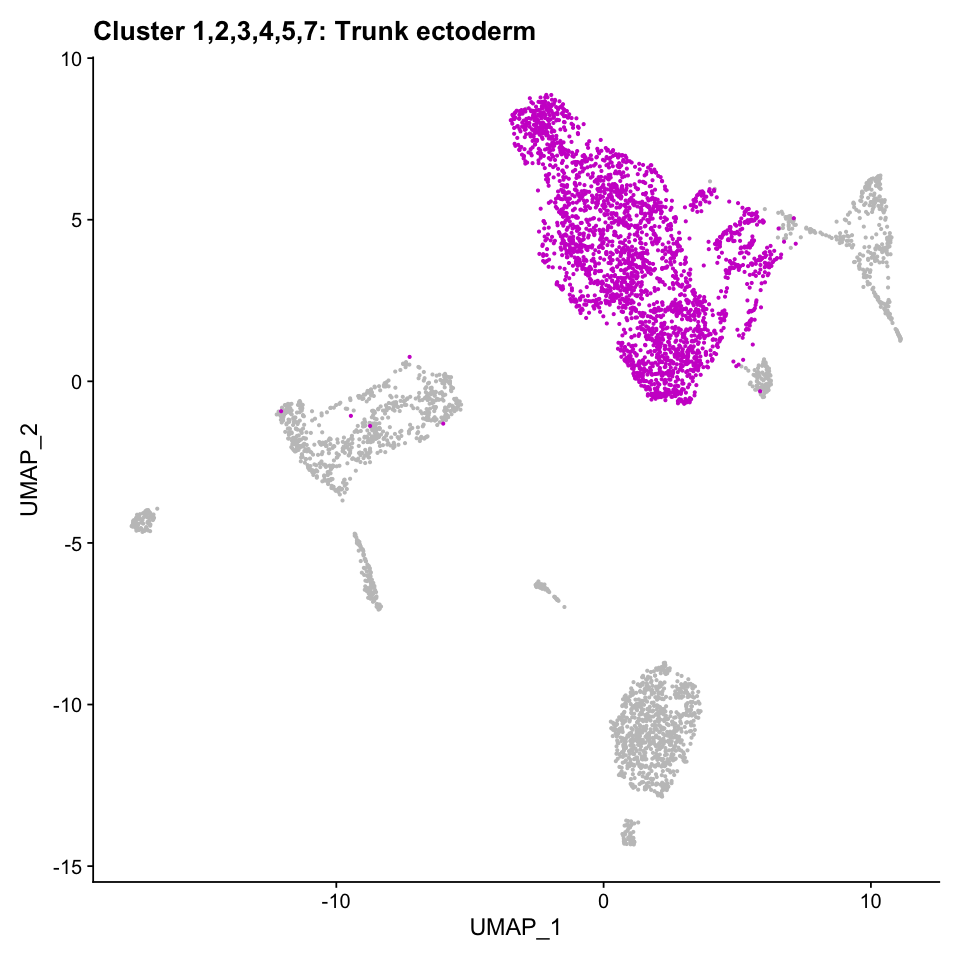

In [4]:
options(repr.plot.width=8, repr.plot.height=8)
highlight.cells <- WhichCells(seu_HQC,idents = c(1,2,3,4,5,7))
fig <- DimPlot(seu_HQC, reduction =  "umap", cells.highlight = highlight.cells, pt.size = 0.5, sizes.highlight = 0.5,
        cols.highlight = 'magenta3', label = FALSE) + NoLegend() + ggtitle('Cluster 1,2,3,4,5,7: Trunk ectoderm')
fig
ggsave(fig, file = './figures/04_lateral_ecto_subclutering_Set2/Highlight_lateral_ecto.eps')

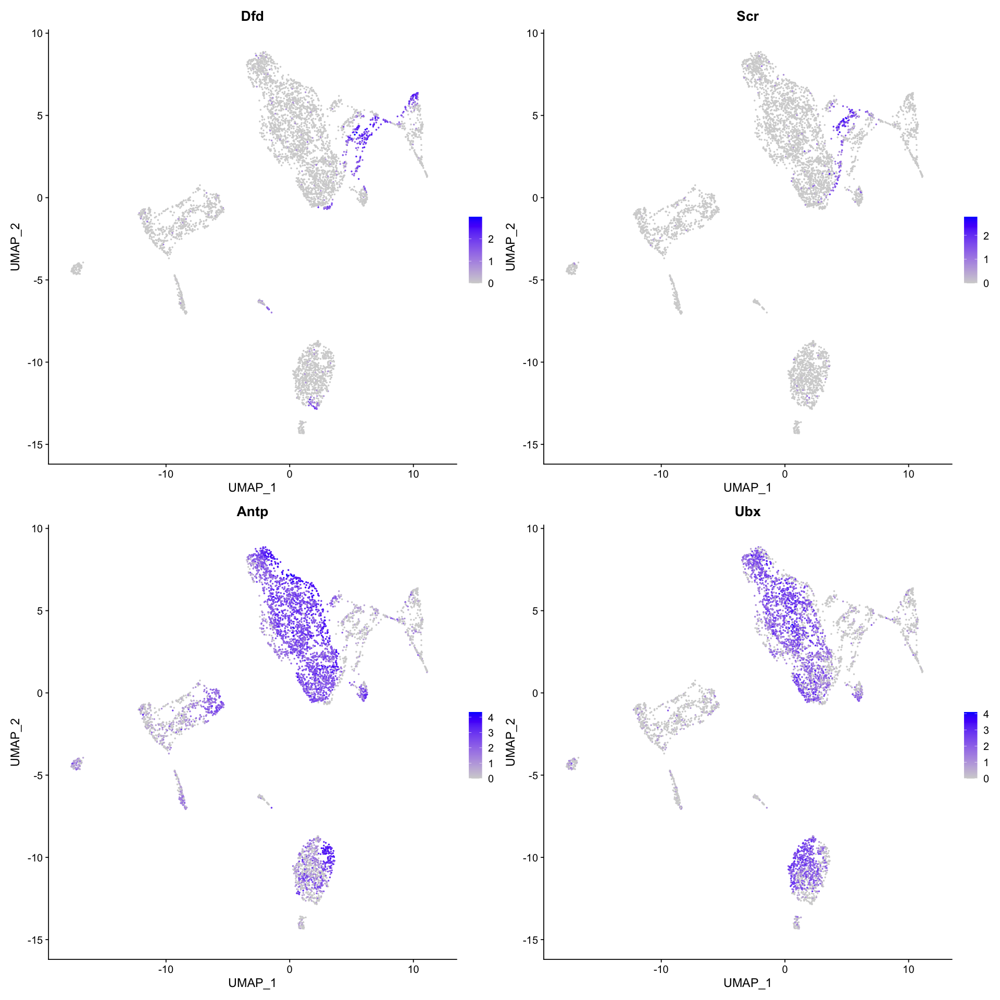

In [5]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu_HQC, reduction = "umap", features = c('Dfd','Scr','Antp','Ubx'),ncol = 2)

In [6]:
seu.ecto <- subset(seu_HQC,idents = c(1,2,3,4,5,7))
seu.ecto

An object of class Seurat 
28364 features across 2654 samples within 2 assays 
Active assay: SCT (10860 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [7]:
seu.ecto$all_cell_cluster <- seu.ecto$seurat_clusters

## Re-normalize and Add AP annotation

In [8]:
DefaultAssay(seu.ecto) <- 'RNA'
seu.ecto <- suppressWarnings(SCTransform(seu.ecto, vars.to.regress = c('percent.mt','percent.rRNA')))

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 9881 by 2654

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2654 cells



  |======================================================================| 100%


Found 96 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 9881 genes



  |======================================================================| 100%


Computing corrected count matrix for 9881 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 44.2243 secs

Determine variable features

Set 3000 variable features

Place corrected count matrix in counts slot

Regressing out percent.mt, percent.rRNA

Centering data matrix

Set default assay to SCT



PC_ 1 
Positive:  SoxN, sog, sca, ths, Toll-6, D, ImpL2, Cys, Tet, CG43355-sala 
	   slp1, brk, gsb, E(spl)mgamma-HLH, Tollo, Meltrin, wg, Obp99a, path, Dr 
	   sad, ind, l(1)sc, wb, Dl, tkv, Pino, pros, ac, pyr 
Negative:  mirr, tup, CG45263, peb, egr, srp, Dtg, Ance, dap, emc 
	   cv-2, Ama, Svil, ush, hbs, Doc1, Alk, Z600, CG14427, kay 
	   rst, Doc3, prage, MFS14, lncRNA:CR43432, C15, scyl, Nrt, sas, pnr 
PC_ 2 
Positive:  eEF1alpha1, RpL27A, CG43355-sala, Ance, peb, egr, CG13427, RpS4, Ama, mt:CoIII 
	   CG4440, RpS15, RpS18, Fer2LCH, CG10035, Doc1, Doc3, Dtg, RpS11, dap 
	   RpS23, Fer1HCH, Z600, RpL19, prage, alphaTub84B, betaTub56D, srp, mt:CoII, CG8960 
Negative:  stg, kis, Egfr, ths, aop, wb, tsh, hth, SoxN, Tollo 
	   wech, dpp, ImpL2, Toll-6, Brd, zld, mtd, lncRNA:CR43887, shn, robo2 
	   E(spl)mgamma-HLH, Dl, CG10011, Meltrin, spen, Ubx, Alh, CG11873, nej, Nrt 
PC_ 3 
Positive:  stg, dpp, Atx-1, bbg, Ama, Egfr, shn, bnl, CG10035, CG13427 
	   Dll, CG10011, CG34224, lncRNA:

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2654
Number of edges: 90996

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7240
Number of communities: 7
Elapsed time: 0 seconds


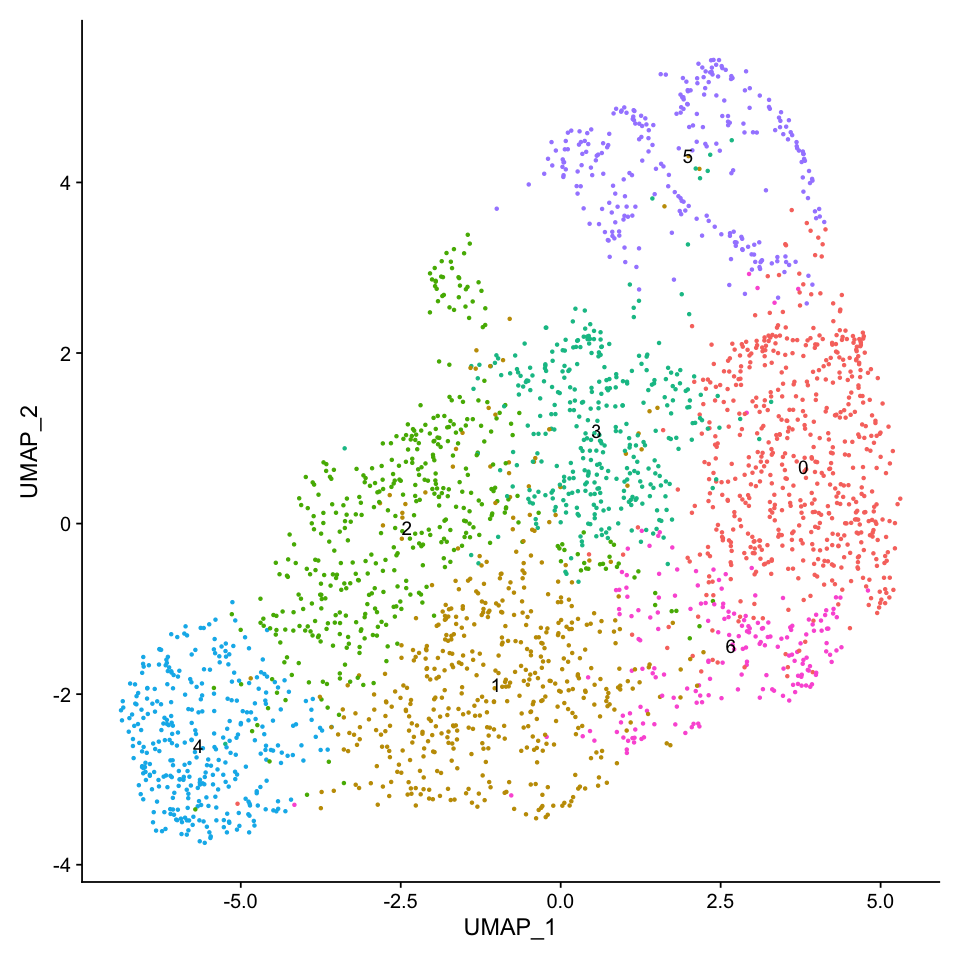

In [9]:
options(repr.plot.width=8, repr.plot.height=8)
seu.ecto <- RunPCA(seu.ecto)
seu.ecto <- RunUMAP(seu.ecto, dims = 1:30)
seu.ecto <- FindNeighbors(seu.ecto, dims = 1:30)
seu.ecto <- FindClusters(seu.ecto)
DimPlot(seu.ecto, reduction = 'umap', label = T) + NoLegend()

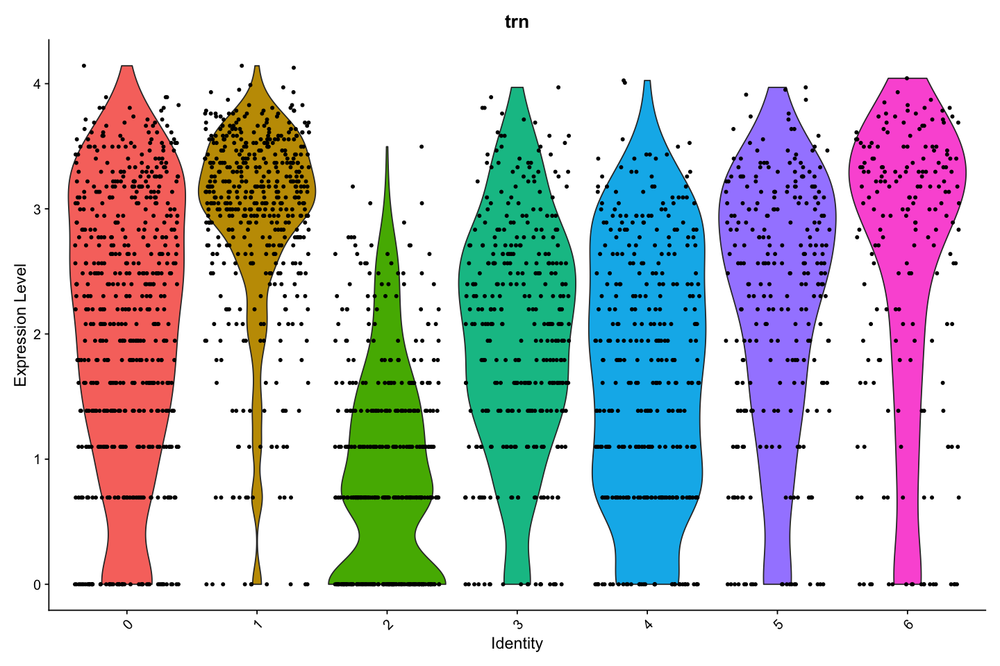

In [10]:
options(repr.plot.width=12, repr.plot.height=8)
VlnPlot(seu.ecto, features = 'trn') + NoLegend()

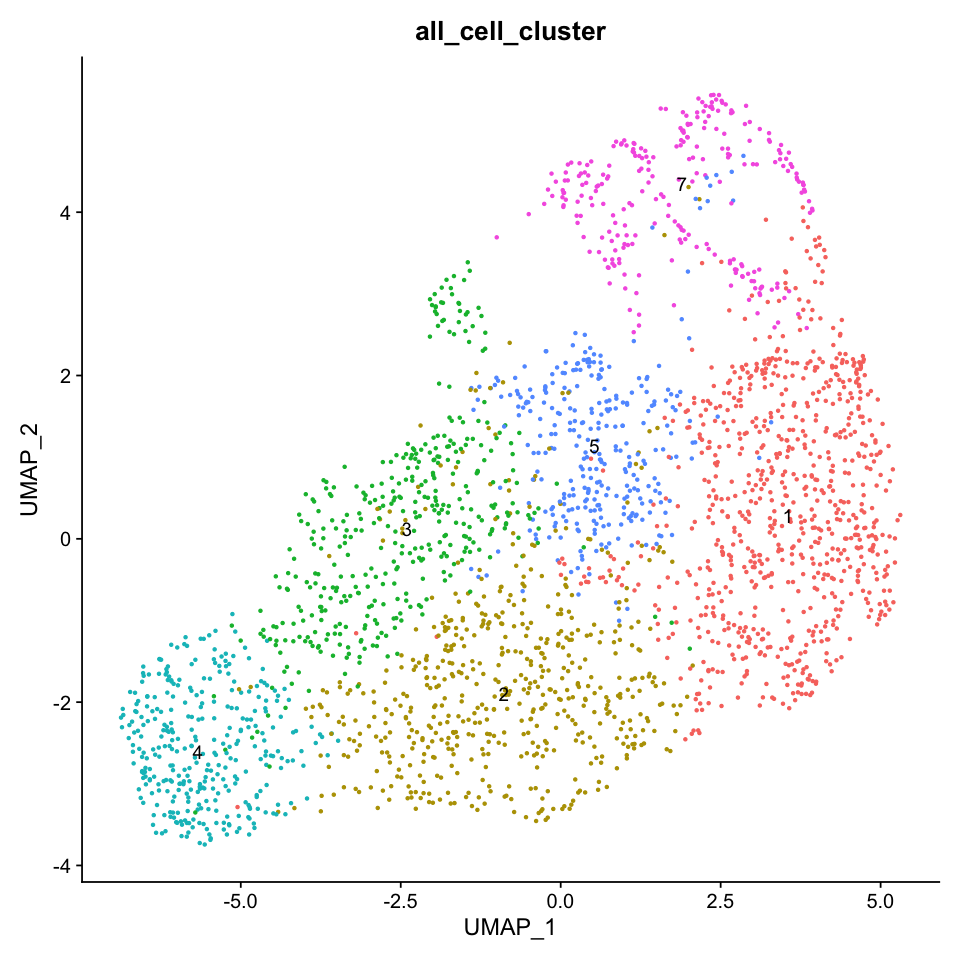

In [11]:
#clustering results (Seurat clusters) on whole embryo
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', label = TRUE, group.by = 'all_cell_cluster') + NoLegend()

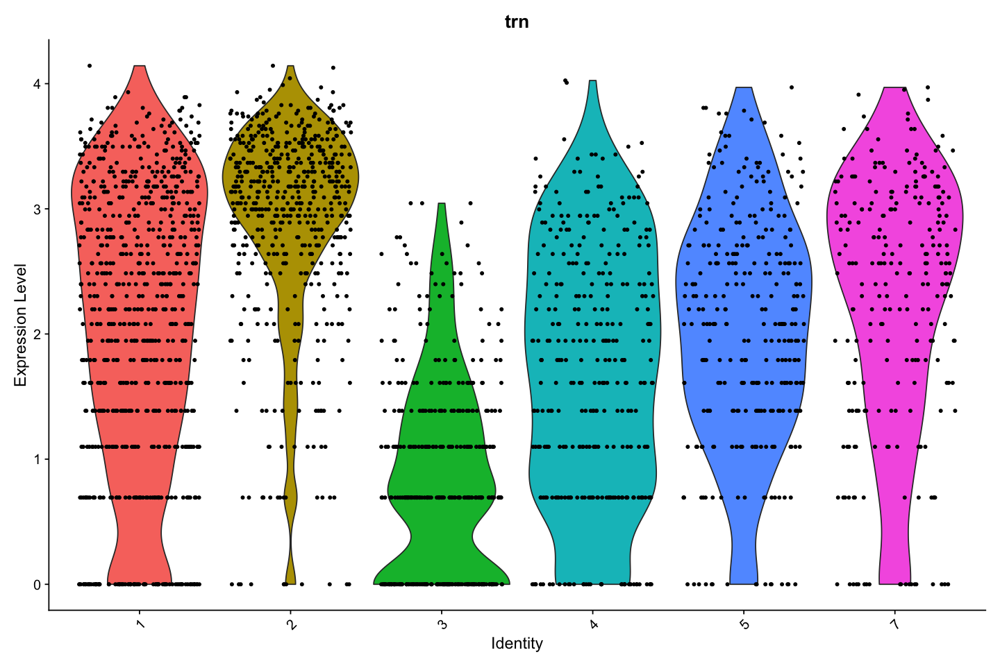

In [12]:
options(repr.plot.width=12, repr.plot.height=8)
VlnPlot(seu.ecto, features = 'trn', group.by = 'all_cell_cluster') + NoLegend()

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2654
Number of edges: 90996

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6987
Number of communities: 10
Elapsed time: 0 seconds


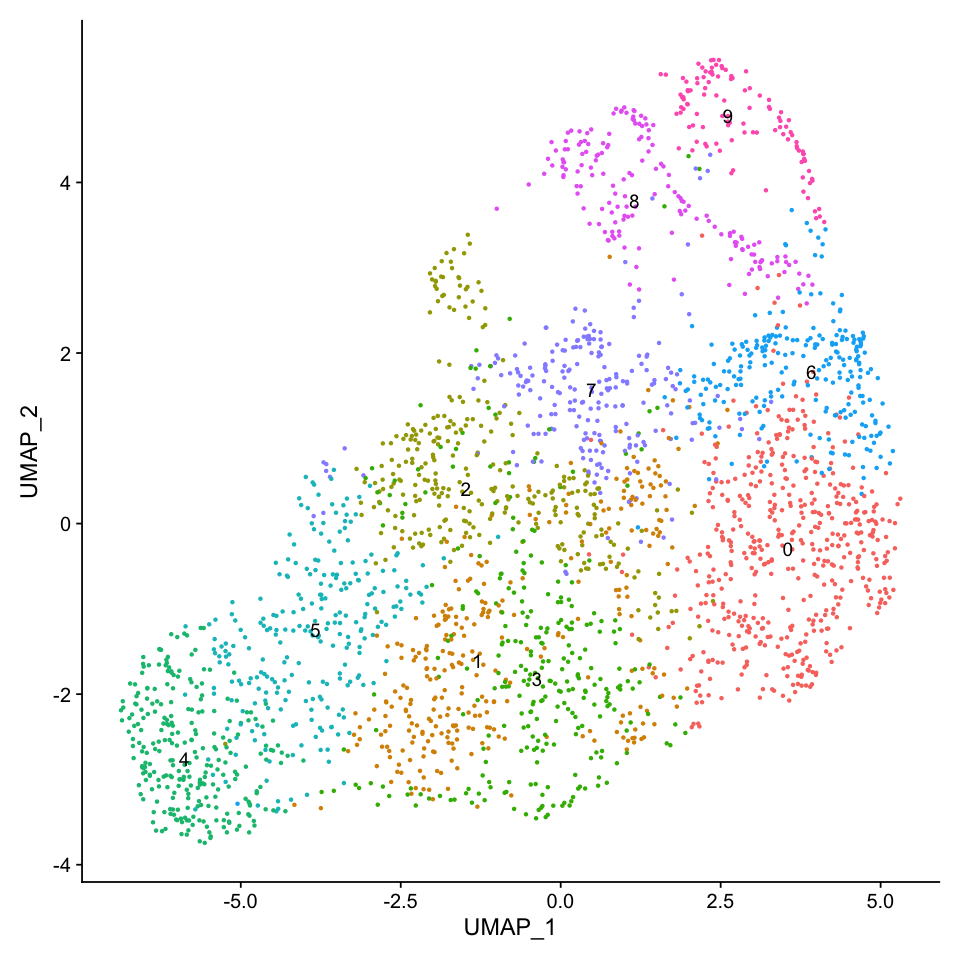

In [13]:
options(repr.plot.width=8, repr.plot.height=8)
seu.ecto <- FindClusters(seu.ecto, resolution = 1.0)
DimPlot(seu.ecto, reduction = 'umap', label = TRUE) + NoLegend()

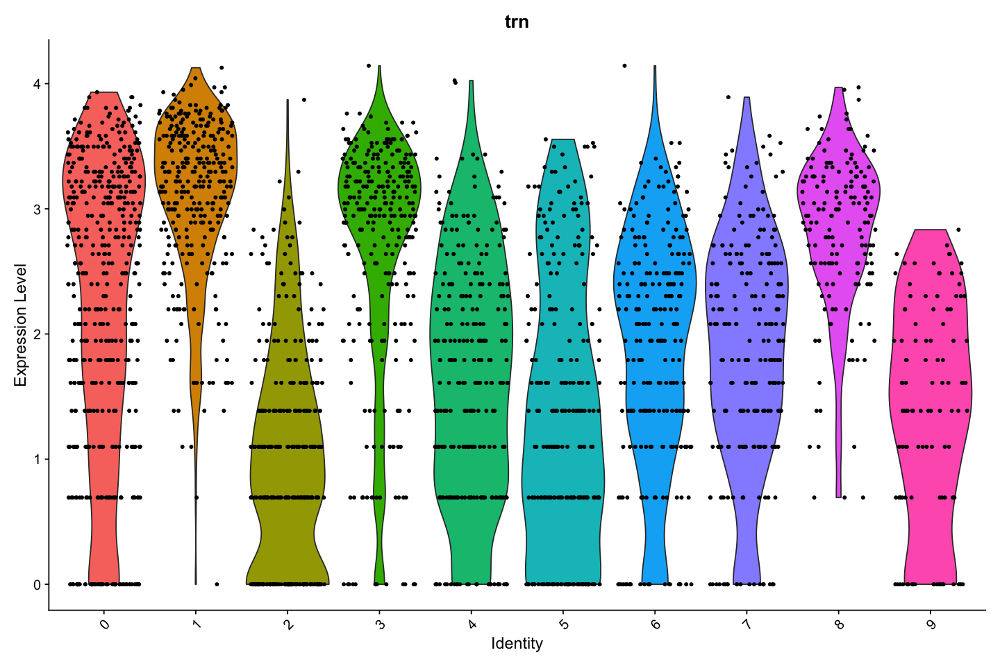

In [14]:
options(repr.plot.width=12, repr.plot.height=8)
VlnPlot(seu.ecto, features = 'trn') + NoLegend()

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2654
Number of edges: 90996

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7093
Number of communities: 10
Elapsed time: 0 seconds


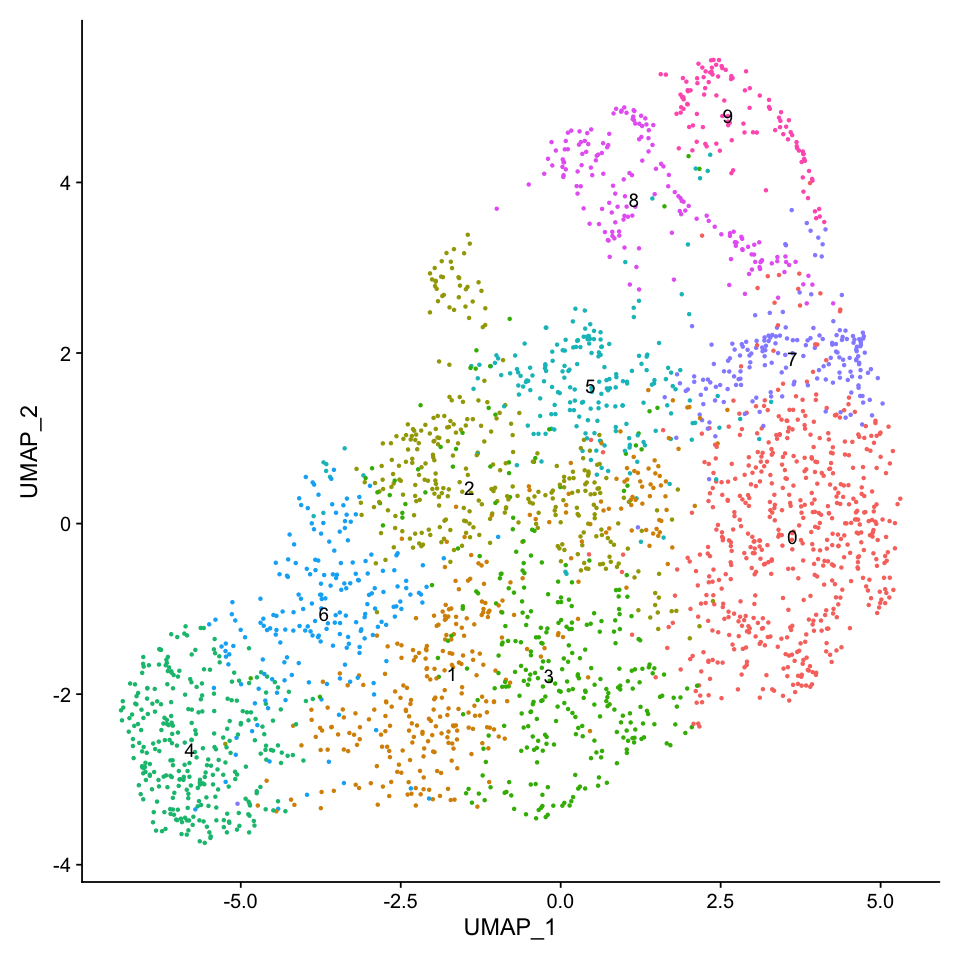

In [15]:
options(repr.plot.width=8, repr.plot.height=8)
seu.ecto <- FindClusters(seu.ecto, resolution = 0.9)
DimPlot(seu.ecto, reduction = 'umap', label = TRUE) + NoLegend()

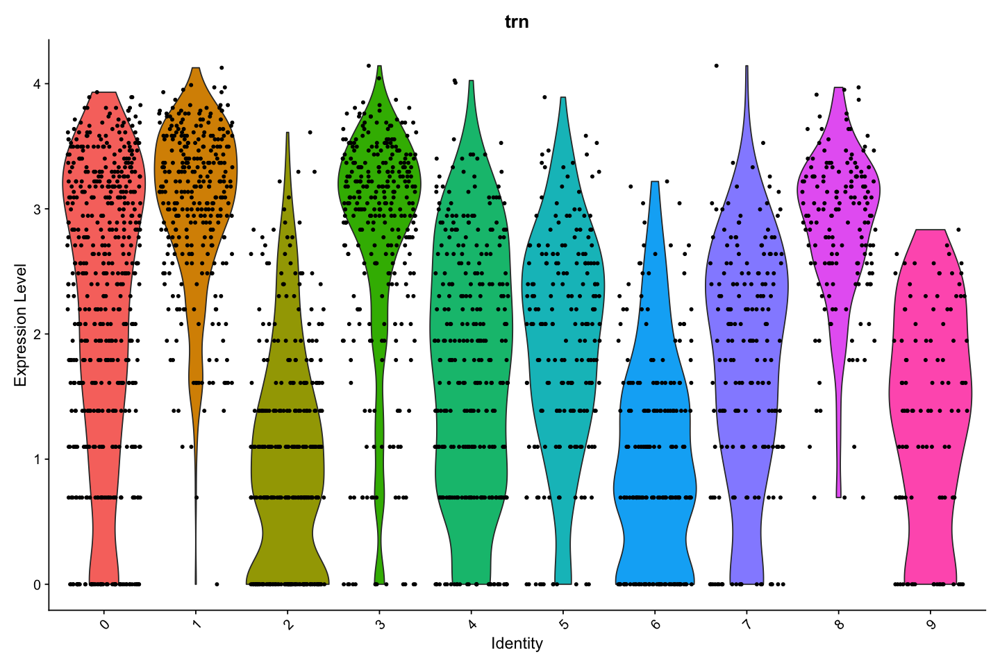

In [16]:
options(repr.plot.width=12, repr.plot.height=8)
VlnPlot(seu.ecto, features = 'trn') + NoLegend()

Cluster 1 & cluster 3 were even.  
Cluster 2 & cluster 6 were odd.  
Clearer than resolution = 1.0

In [17]:
all.markers.ecto <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers.ecto)
all.markers.ecto.top10 <- all.markers.ecto %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.ecto.top10)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9



[1] 680

[1] 100

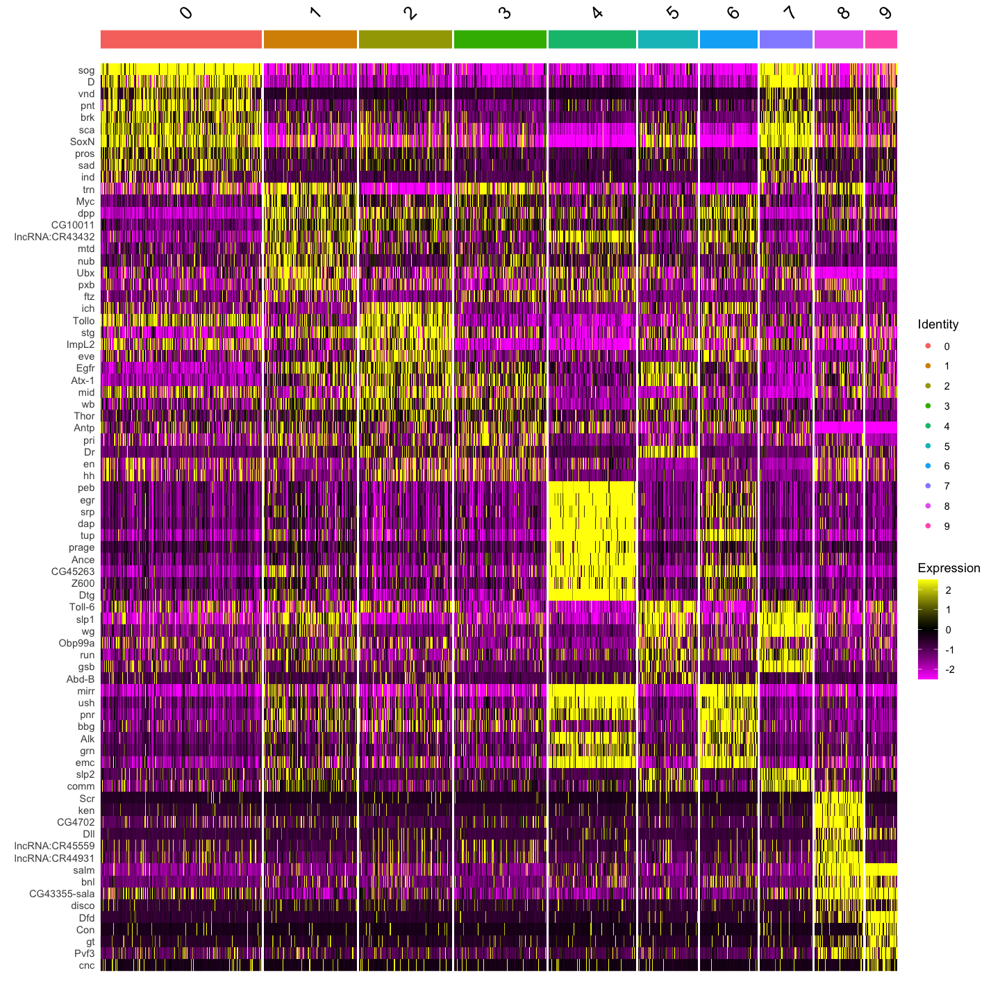

In [18]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto, features = c(all.markers.ecto.top10$gene))

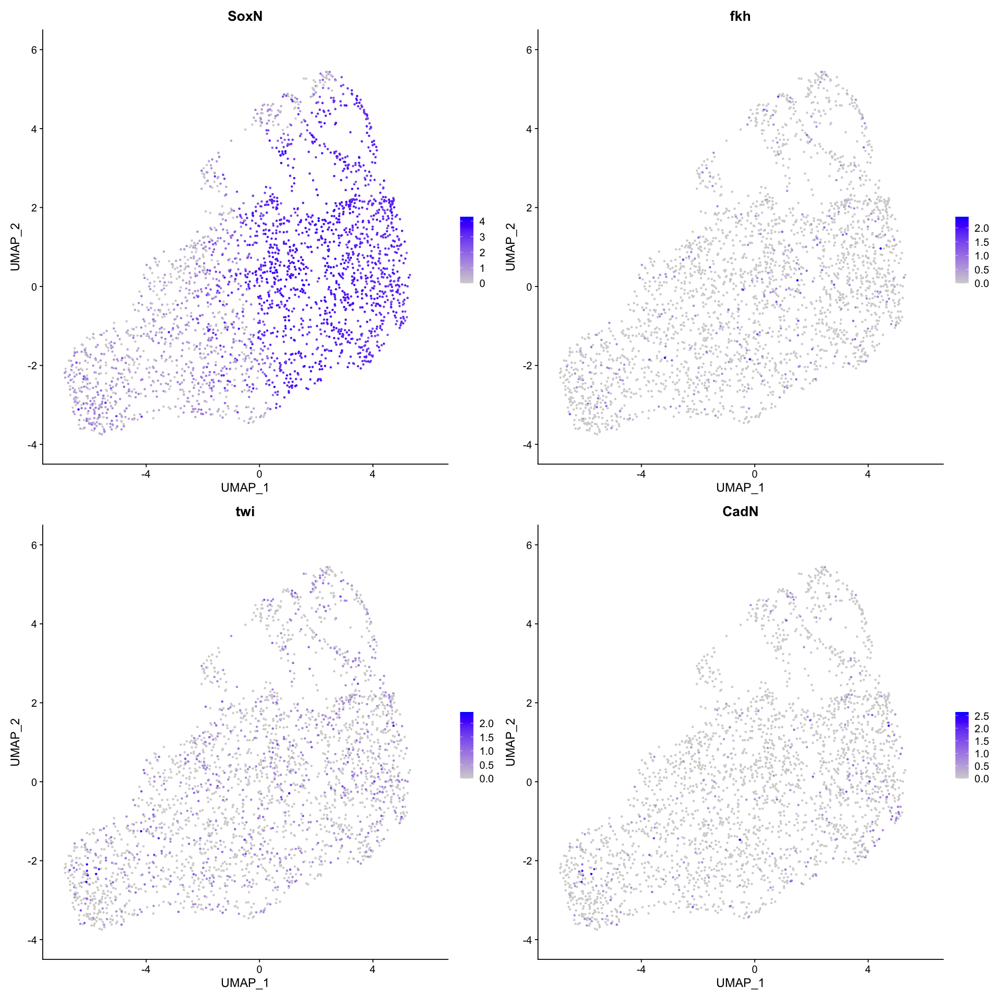

In [19]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('SoxN','fkh','twi','CadN'))

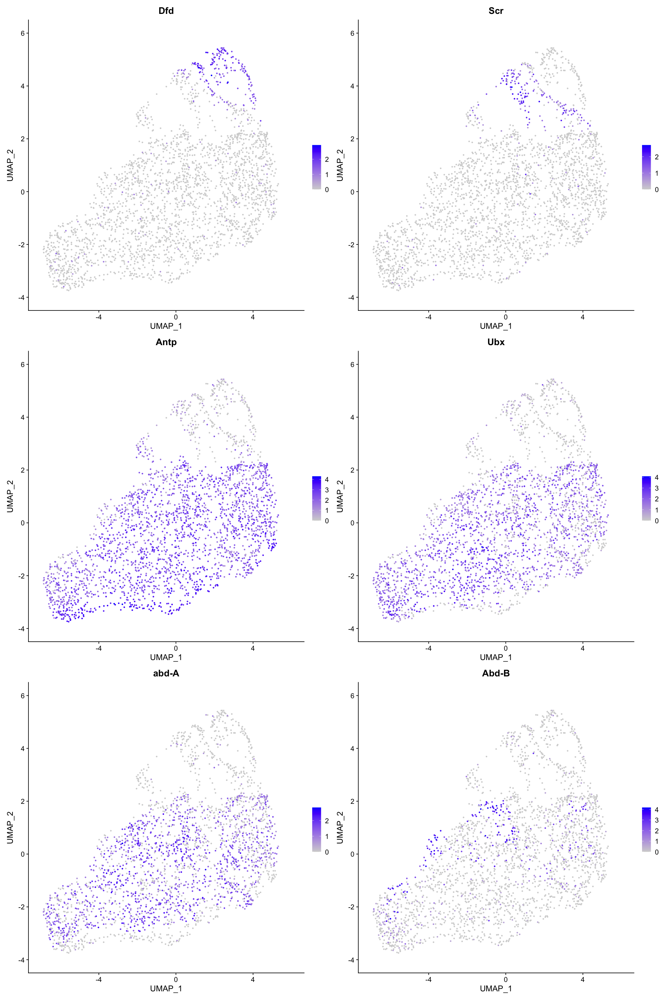

In [20]:
options(repr.plot.width=16, repr.plot.height=24)
FeaturePlot(seu.ecto, reduction = "umap", features = c('Dfd','Scr','Antp','Ubx','abd-A','Abd-B'),ncol = 2)

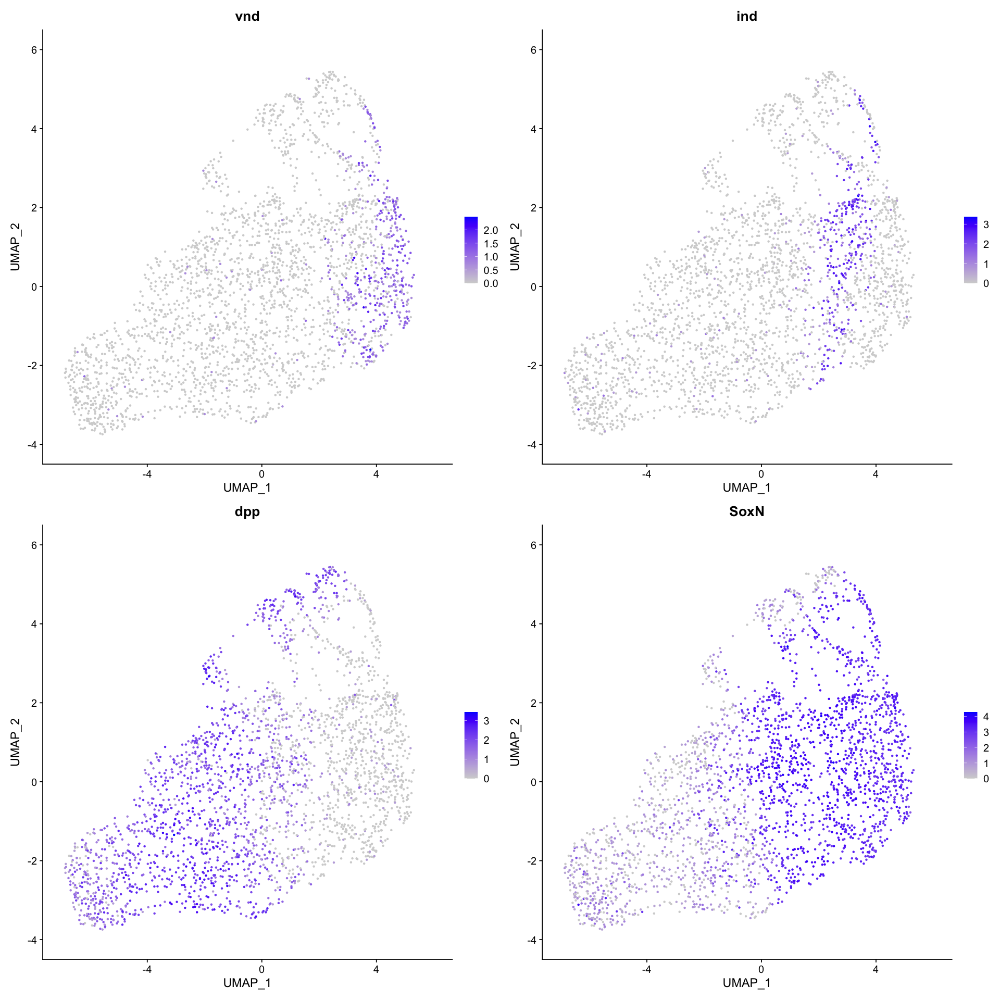

In [21]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('vnd','ind','dpp','SoxN'),ncol = 2)

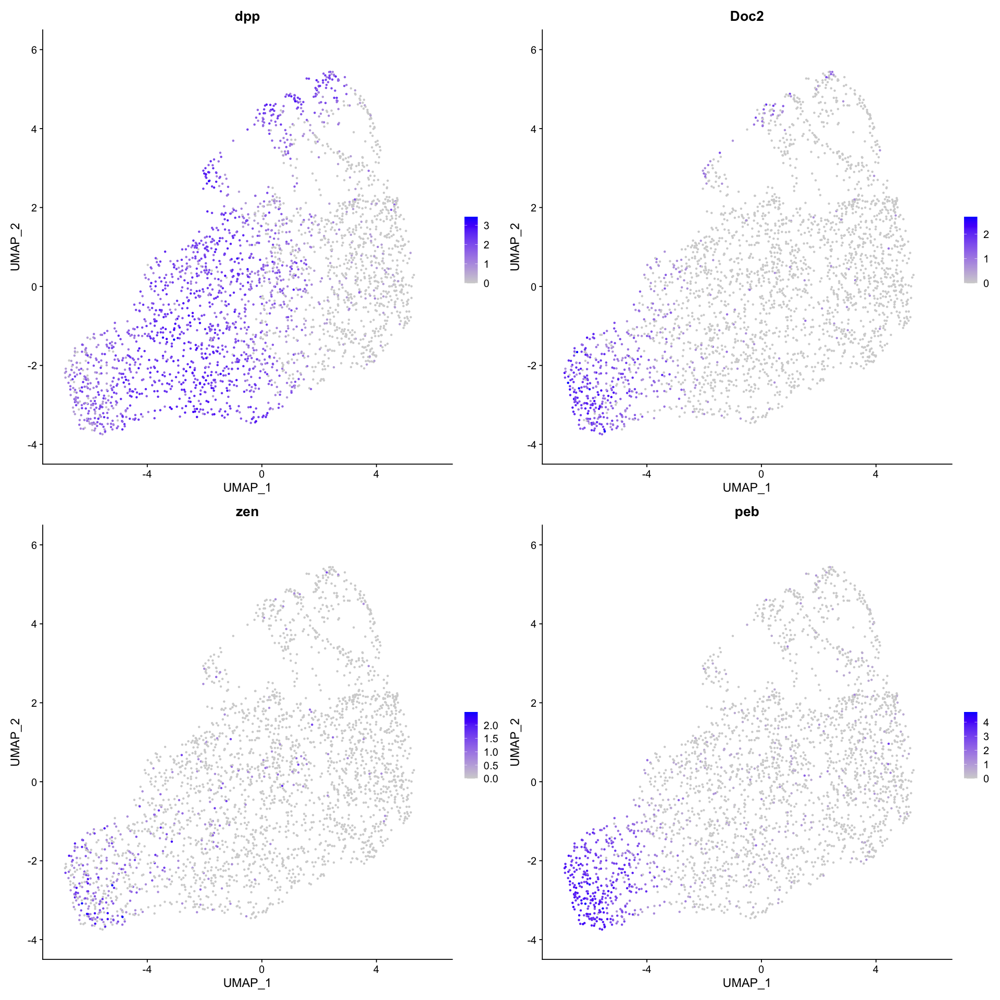

In [22]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('dpp','Doc2','zen','peb'),ncol = 2)

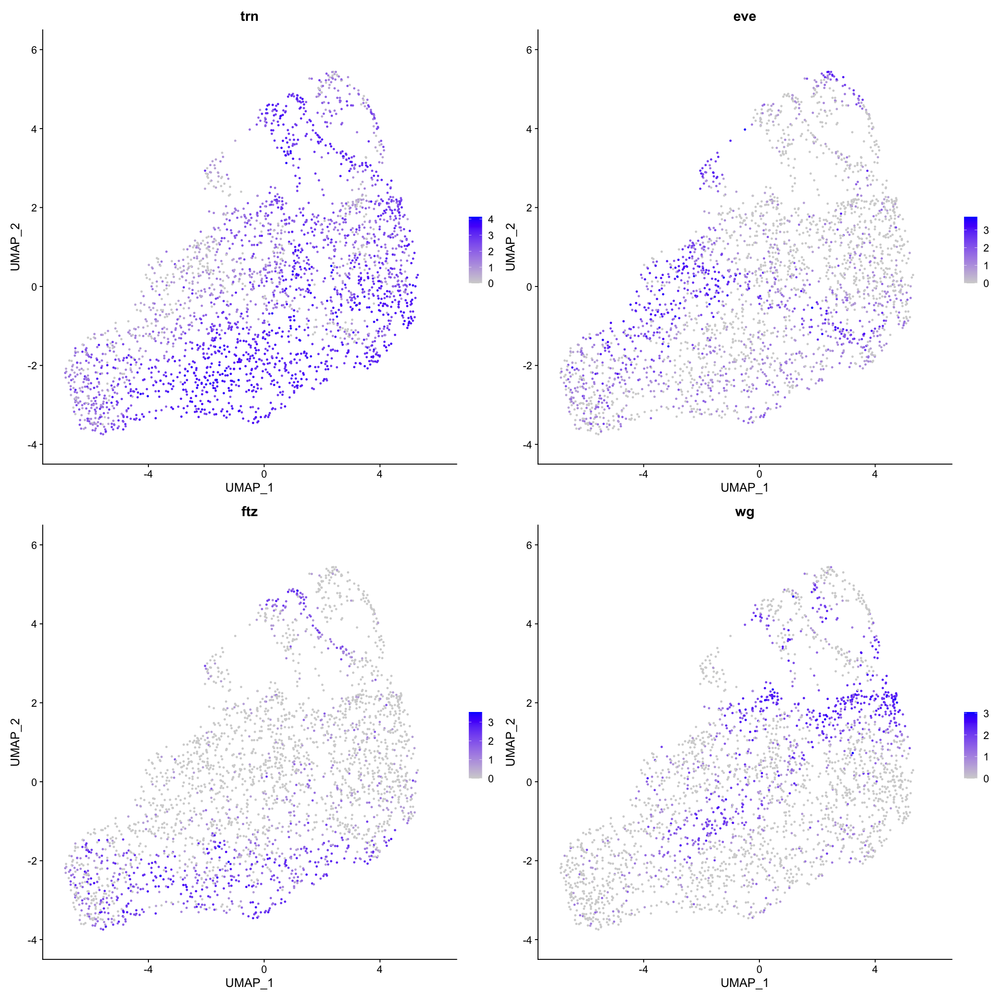

In [23]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('trn','eve','ftz','wg'),ncol = 2)

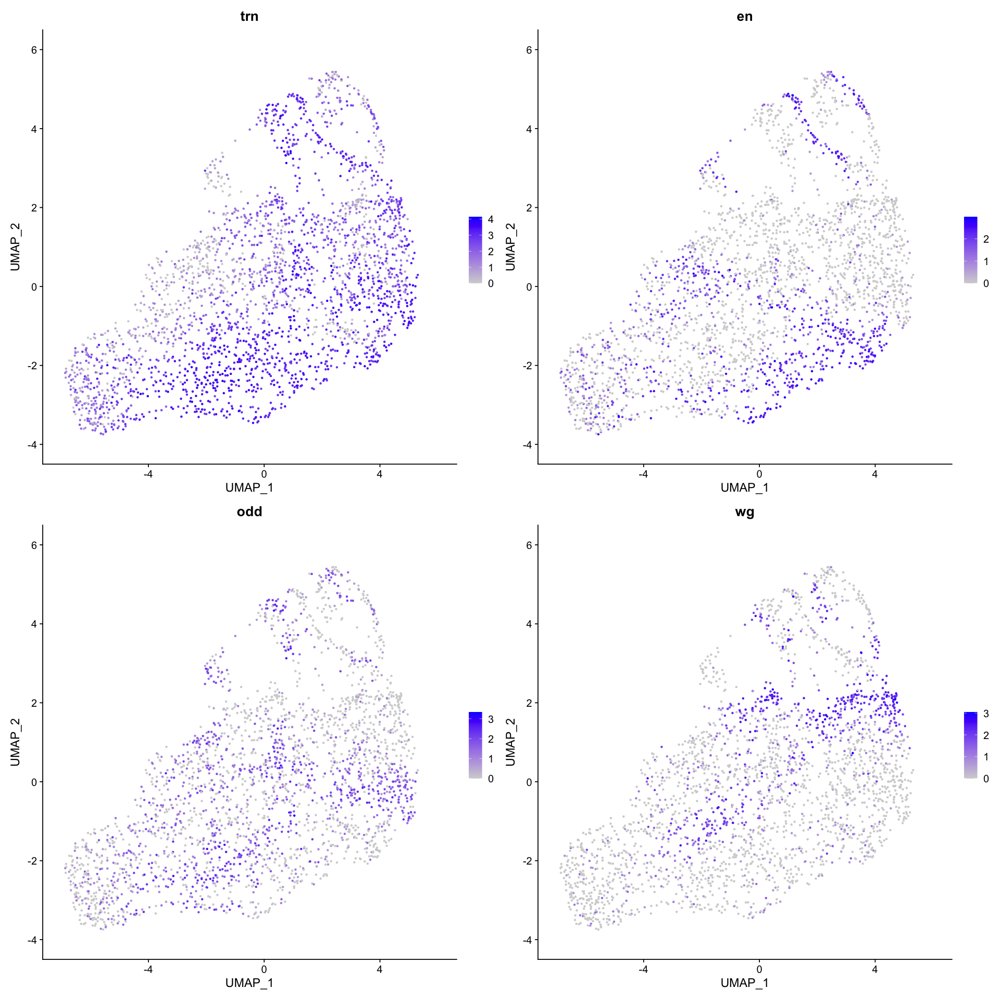

In [24]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('trn','en','odd','wg'),ncol = 2)

In [25]:
path = './figures/04_lateral_ecto_subclutering_Set2'
for (name in c("trn","eve","en","wg","Dfd", "Scr", "Antp", "Ubx", "abd-A","Abd-B")){
    options(repr.plot.width=8, repr.plot.height=8)
    p <- FeaturePlot(seu.ecto, features = name) + theme(plot.title = element_blank())
    basename = paste(name, 'Set2_lateral_ecto.eps',sep = '_')
    filename = paste(path, basename, sep = '/')
    ggsave(p, file = filename, width = 8, height = 8)
}

In [26]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = TRUE) + NoLegend()
ggsave(fig, file = './figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_seurat_clusters_Set2.eps', width = 8, height = 8)

trn+/trn- cells were mixed. (even/odd parasegment cannot be separated) in ventral side

In [27]:
manual_id <- as.data.frame(seu.ecto$seurat_clusters)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID <- dplyr::recode(manual_id$manual_ID, 
                                "0" = "abdominal",
                                "1" = "abdominal_even", 
                                "2" = "abdominal_odd", 
                                "3" = "abdominal_even", 
                                "4" = "amnioserosa",
                                "5" = "abdominal",
                                "6" = "abdominal_odd", 
                                "7" = "abdominal", 
                                "8" = "PS2", #Scr+
                                "9" = "PS1" #Dfd+
                                )
head(manual_id)

,manual_ID
,<fct>
AAACCCATCCGTGTCT,0
AAACGAAAGAATCGTA,4
AAACGAAAGACTTCCA,4
AAACGAATCAAGCCTA,2
AAACGCTCACAGTATC,3
AAACGCTGTCGAACGA,4


,manual_ID
,<fct>
AAACCCATCCGTGTCT,abdominal
AAACGAAAGAATCGTA,amnioserosa
AAACGAAAGACTTCCA,amnioserosa
AAACGAATCAAGCCTA,abdominal_odd
AAACGCTCACAGTATC,abdominal_even
AAACGCTGTCGAACGA,amnioserosa


In [28]:
seu.ecto$AP_ID <- manual_id$manual_ID

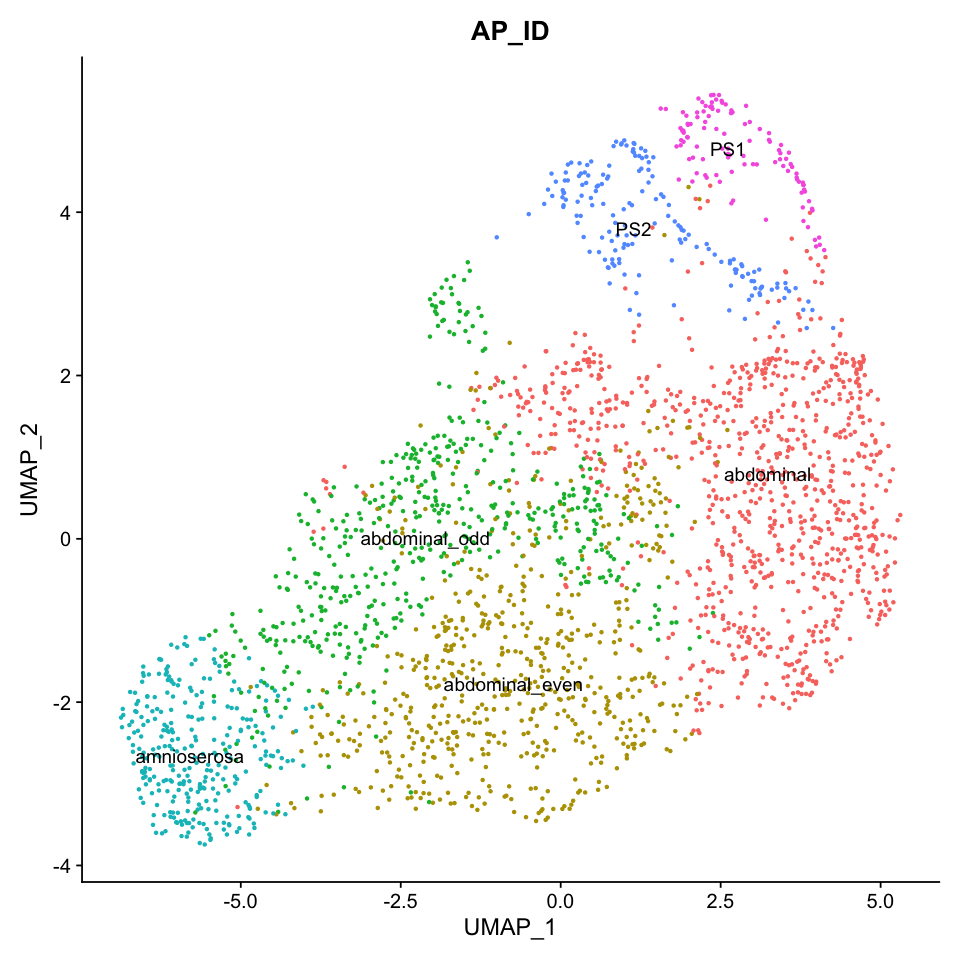

In [29]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', label = TRUE, group.by = 'AP_ID') + NoLegend()

In [30]:
Idents(seu.ecto) <- 'AP_ID'
levels(seu.ecto) <- c('amnioserosa','PS1','PS2','abdominal_even','abdominal_odd','abdominal')
all.markers.ecto <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers.ecto)
all.markers.ecto.top10 <- all.markers.ecto %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.ecto.top10)

Calculating cluster amnioserosa

Calculating cluster PS1

Calculating cluster PS2

Calculating cluster abdominal_even

Calculating cluster abdominal_odd

Calculating cluster abdominal



[1] 419

[1] 60

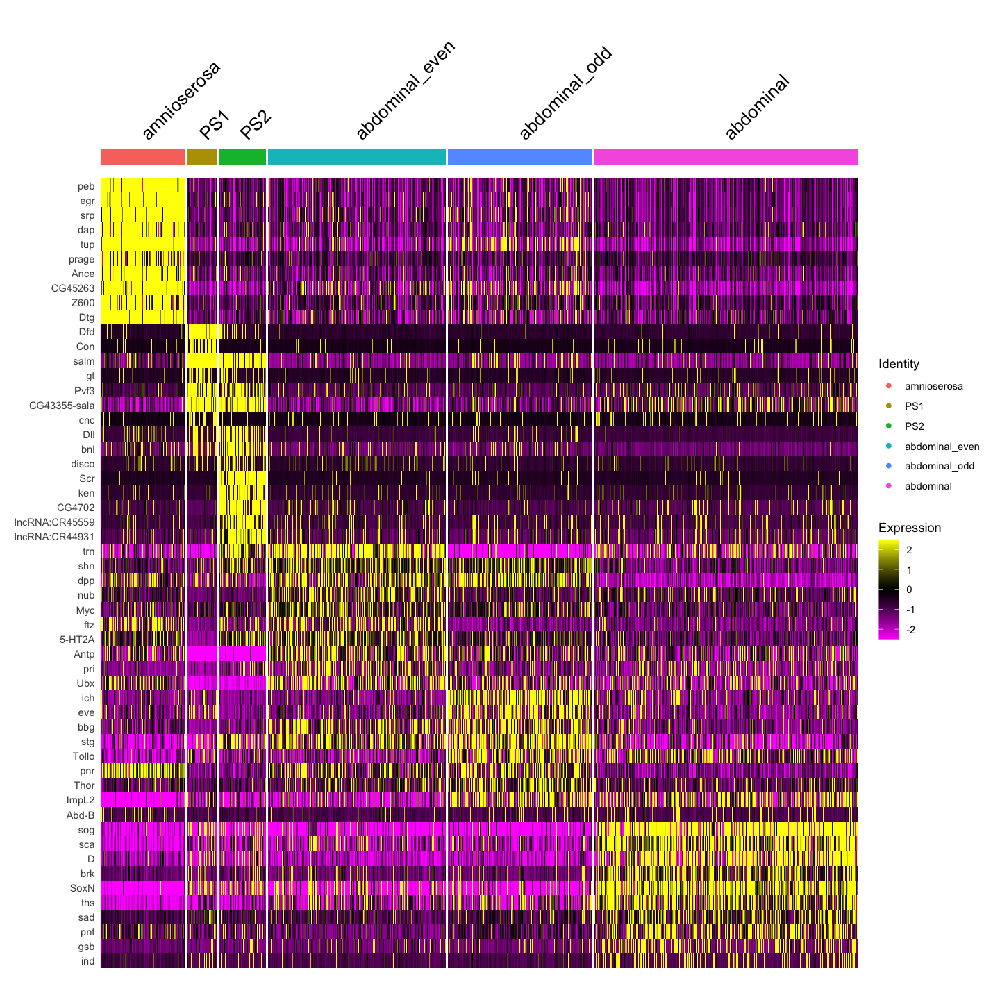

In [31]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto, features = c(all.markers.ecto.top10$gene))

In [32]:
levels <- read.table(file="./lateral_ect_AP_levels_color.txt")
colors <- levels[,2]
levels <- levels[,1]
head(levels)
length(levels)
head(colors)

[1] "PS1"            "PS2"            "abdominal_odd"  "abdominal_even"
[5] "abdominal"      "amnioserosa"

[1] 6

[1] "skyblue1"      "skyblue3"      "plum3"         "olivedrab3"   
[5] "darkslateblue" "gray75"

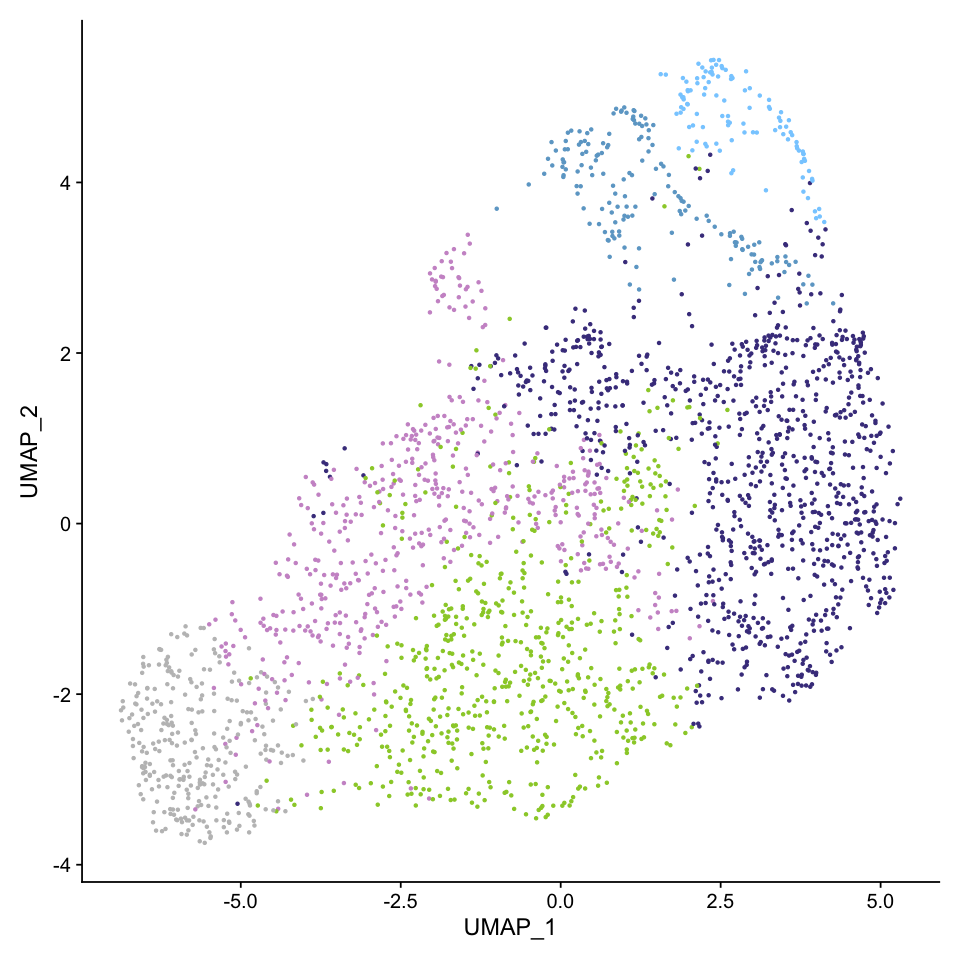

In [33]:
Idents(seu.ecto) <- 'AP_ID'
levels(seu.ecto) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE, cols = colors) + NoLegend() 
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_umap_AP_IDs.eps", dpi = 300, width =8, height = 8)

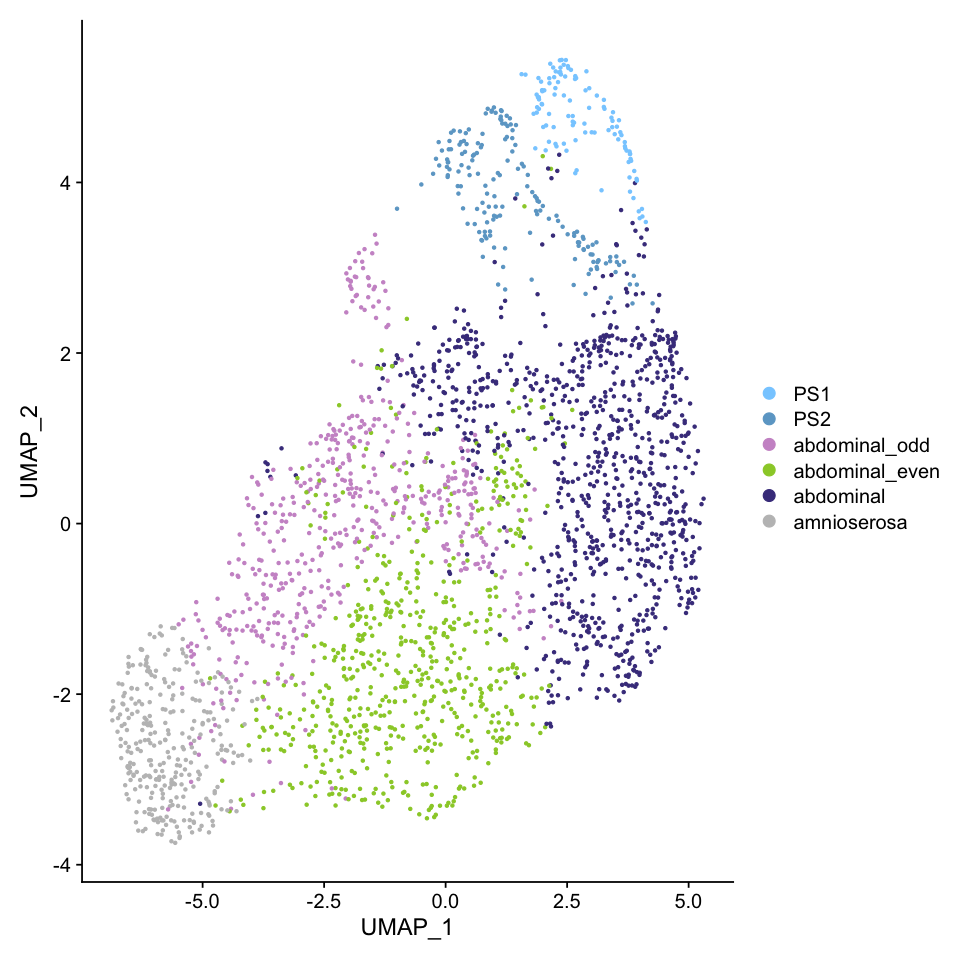

In [34]:
Idents(seu.ecto) <- 'AP_ID'
levels(seu.ecto) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE, cols = colors)
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_umap2_AP_IDs.eps", dpi = 300, width =8, height = 8)

## Annotation by DV-genes

In [35]:
DV_genes <- c("rho", "vnd", "pnt", "ind", "sog", "SoxN", "brk", "dpp", "Egfr", "vn", "pnt",
              "Atx-1", "egr", "cv-2", "Doc1", "Ance", "Dr", "emc", "cic",
              "mirr", "ush", "Ama", "bbg", "tup", "zen", "Doc2", "Z600", "C15", "peb",
             "Dtg", "CG13653", "Doc3", "dap","srp", "stg")

In [36]:
norm.count.ecto <- GetAssayData(seu.ecto)
norm.count.ecto.dv.genes <- as.matrix(norm.count.ecto[DV_genes,])
head(norm.count.ecto.dv.genes)

,AAACCCATCCGTGTCT,AAACGAAAGAATCGTA,AAACGAAAGACTTCCA,AAACGAATCAAGCCTA,AAACGCTCACAGTATC,AAACGCTGTCGAACGA,AAACGCTTCTGTCGCT,AAAGAACAGCGGGTTA,AAAGGATCAGTAGATA,AAAGGATTCTAACGCA,⋯,TTTGACTTCTTACGGA,TTTGATCGTAATACCC,TTTGATCGTCGGCACT,TTTGATCTCGGTTCAA,TTTGGAGAGAAACACT,TTTGGAGAGGACCCAA,TTTGGAGCAACAACAA,TTTGGAGGTGGCCACT,TTTGGAGTCTGGCCGA,TTTGGTTAGCTAATGA
rho,0.000000,0,1.94591,1.7917595,0.0000000,2.9444390,2.7080502,2.3025851,0.6931472,0,⋯,1.9459101,0.000000,1.386294,2.0794415,0.0000000,0.0000000,0.000000,0.0000000,0.0000000,0.000000
vnd,0.000000,0,0.00000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0,⋯,0.0000000,0.000000,0.000000,0.0000000,0.0000000,0.6931472,1.386294,0.0000000,0.6931472,0.000000
pnt,0.000000,0,0.00000,0.6931472,0.6931472,0.6931472,1.0986123,0.6931472,1.3862944,0,⋯,0.0000000,1.098612,1.609438,0.6931472,0.6931472,2.3025851,2.197225,0.6931472,2.3025851,0.000000
ind,0.000000,0,0.00000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000,0,⋯,0.0000000,0.000000,0.000000,0.6931472,0.0000000,0.0000000,0.000000,1.7917595,0.0000000,0.000000
sog,3.295837,0,0.00000,0.0000000,0.0000000,0.0000000,0.6931472,0.0000000,1.7917595,0,⋯,0.6931472,3.258097,1.098612,0.0000000,1.0986123,4.0253517,4.077537,2.5649494,3.9512437,2.564949
SoxN,3.367296,0,0.00000,1.3862944,3.7135721,0.0000000,0.6931472,0.0000000,2.7725887,0,⋯,0.6931472,3.688879,0.000000,0.0000000,1.3862944,2.9444390,2.890372,3.1780538,3.2188758,3.871201


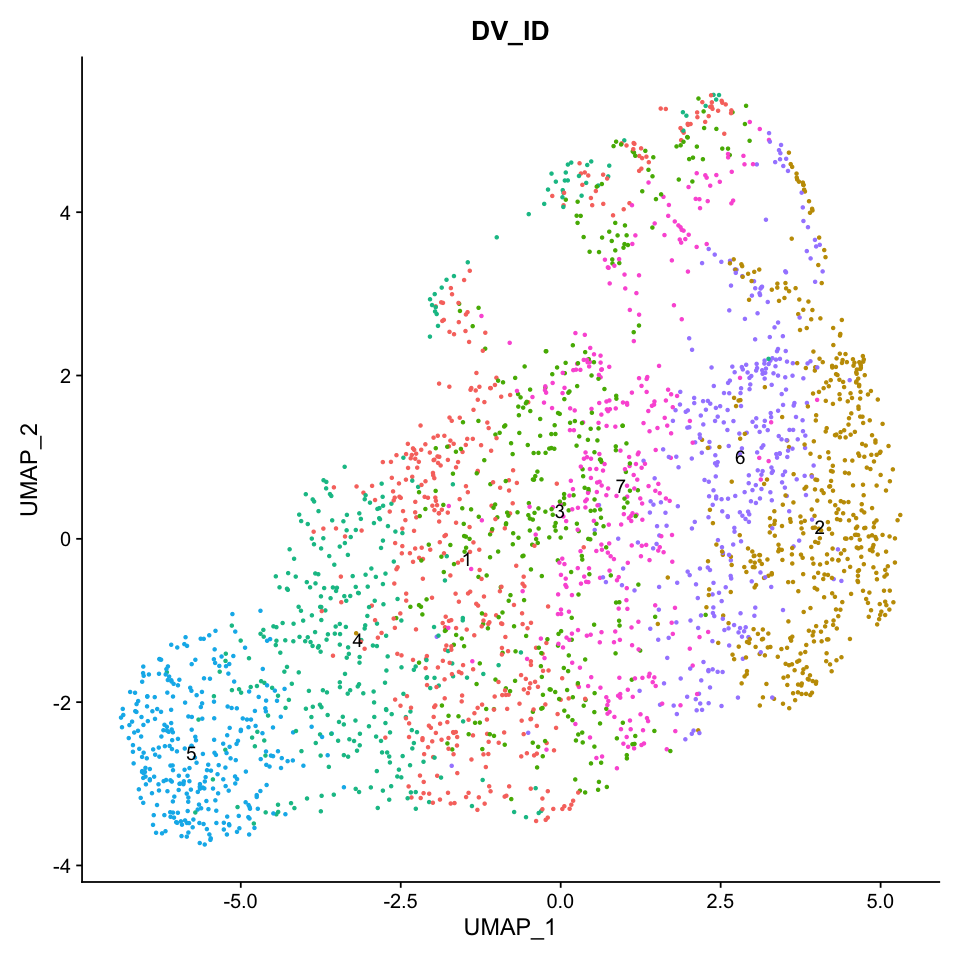

In [37]:
set.seed(4)
trunk_ect_DV_cluster <- kmeans(x=t(norm.count.ecto.dv.genes), centers=7)
seu.ecto$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

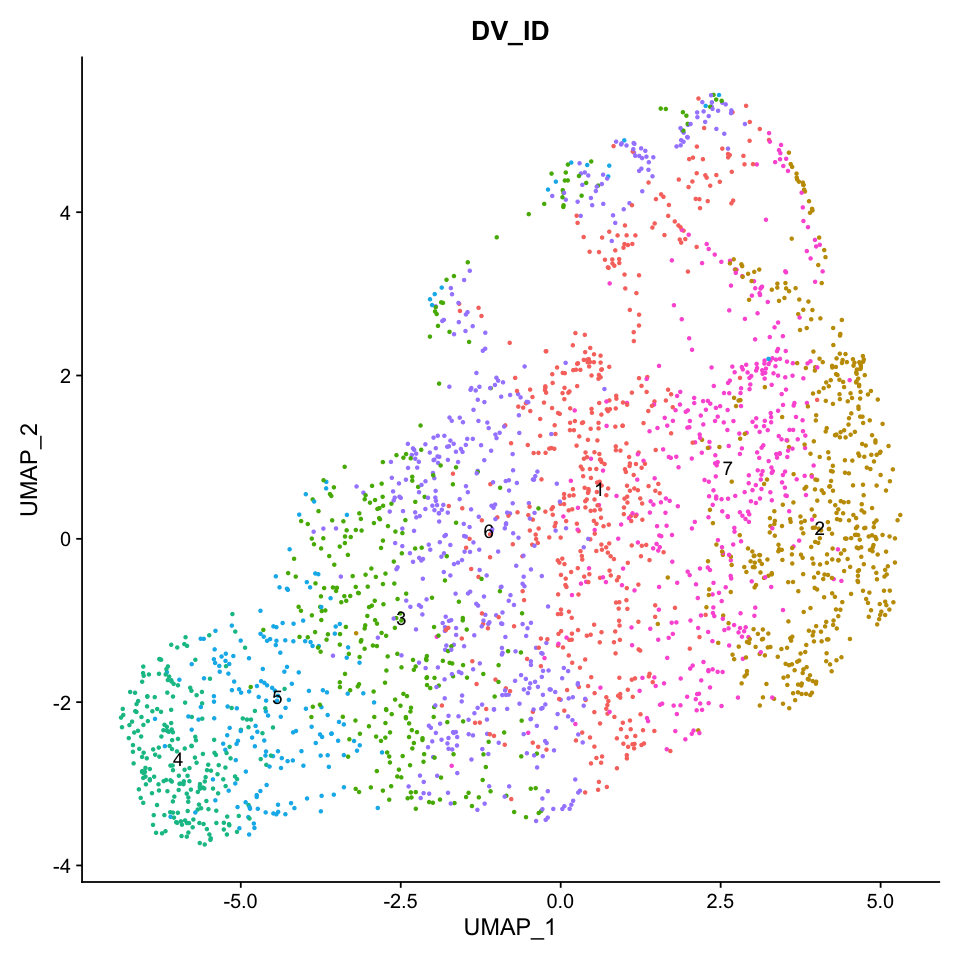

In [38]:
set.seed(6)
trunk_ect_DV_cluster <- kmeans(x=t(norm.count.ecto.dv.genes), centers=7)
seu.ecto$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

In [39]:
Idents(seu.ecto) <- 'DV_ID'
levels(seu.ecto) <- c(2,7,1,6,3,5,4)
all.markers.ecto <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers.ecto)
all.markers.ecto.top10 <- all.markers.ecto %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.ecto.top10)

Calculating cluster 2

Calculating cluster 7

Calculating cluster 1

Calculating cluster 6

Calculating cluster 3

Calculating cluster 5

Calculating cluster 4



[1] 501

[1] 70

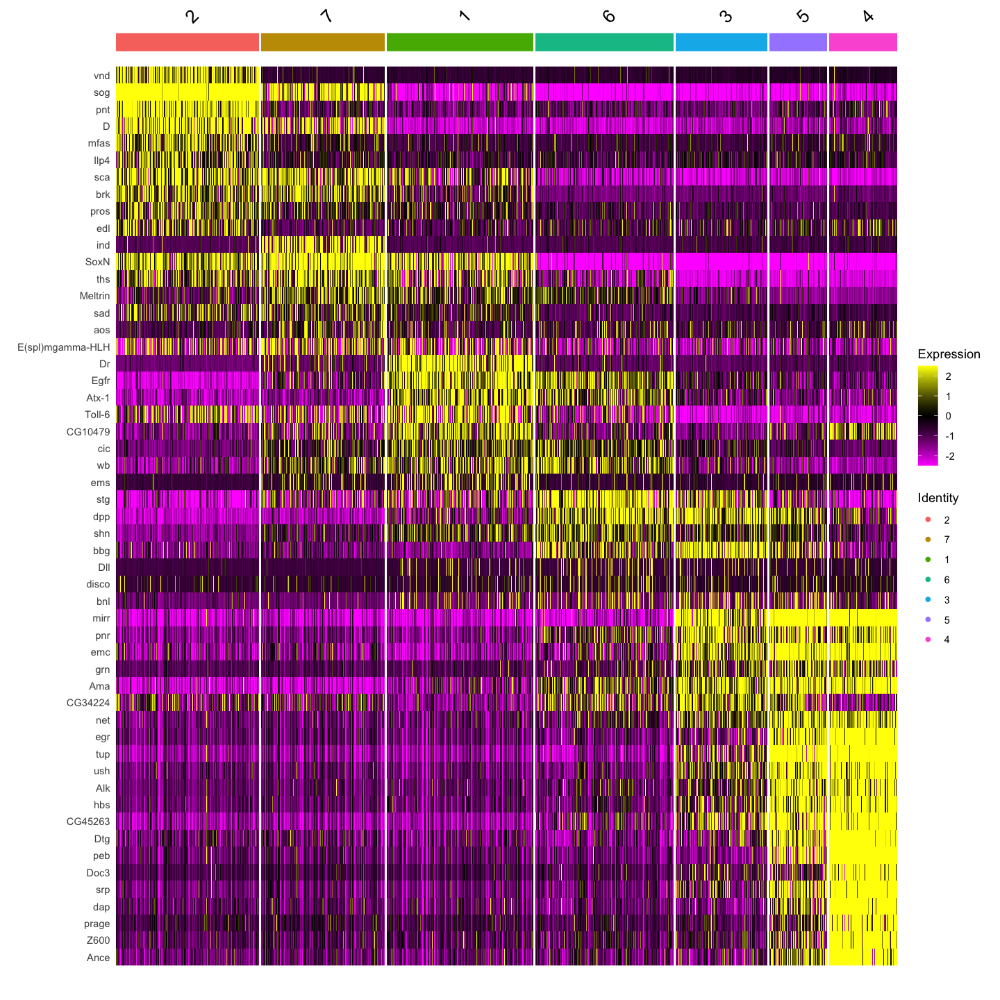

In [40]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto, features = c(all.markers.ecto.top10$gene))

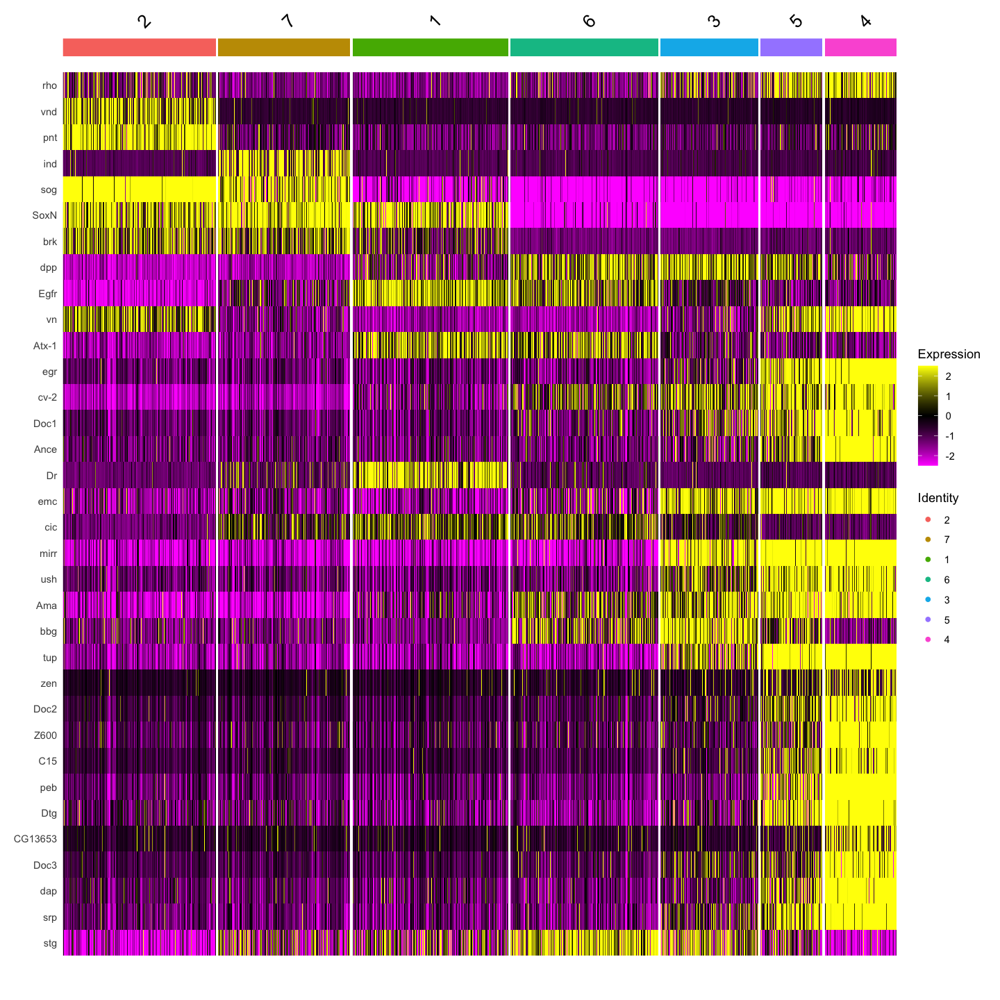

In [41]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto, features = DV_genes)

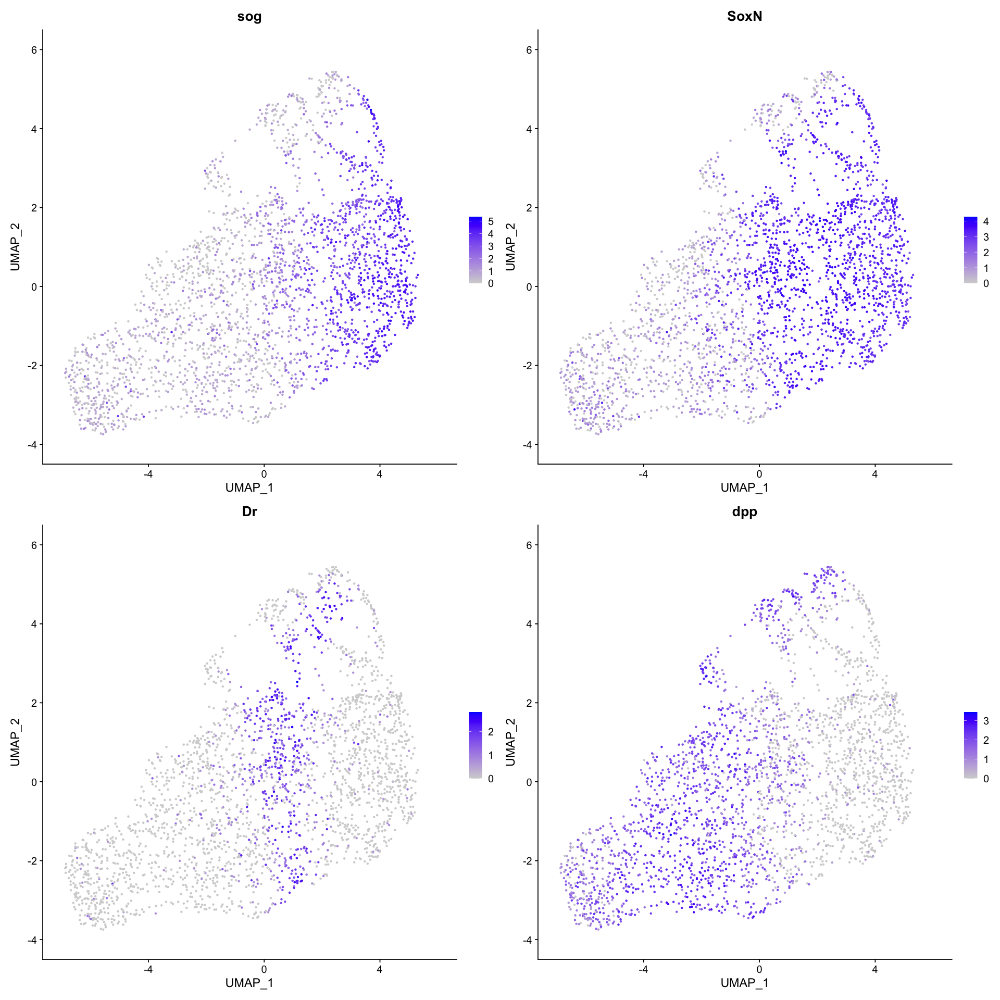

In [42]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('sog','SoxN','Dr','dpp'),ncol = 2)

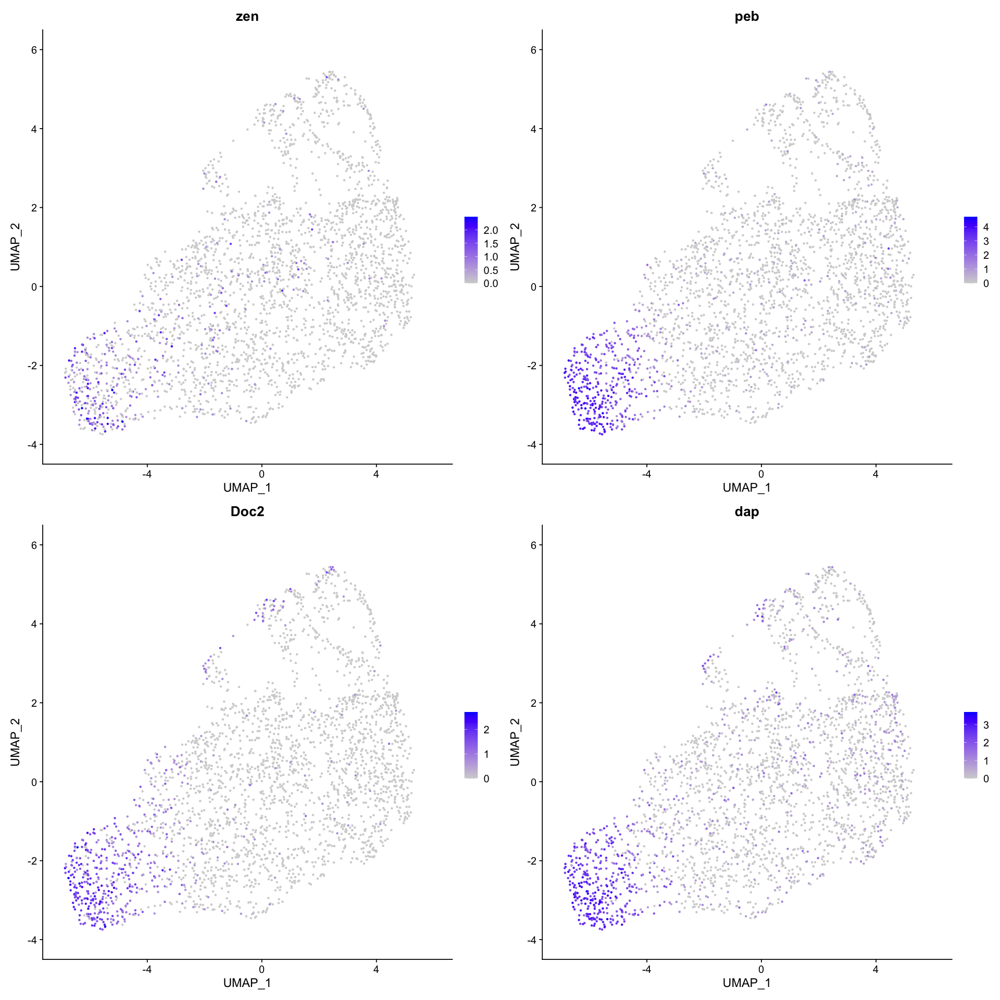

In [43]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = "umap", features = c('zen','peb','Doc2','dap'),ncol = 2)

In [44]:
#Add DV_ID
manual_id <- as.data.frame(seu.ecto$DV_ID)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID <- dplyr::recode(manual_id$manual_ID, 
                                "2" = "ectoderm_medial_NE", 
                                "7" = "ectoderm_intermediate_NE",
                                "1" = "ectoderm_lateral_NE",
                                "6" = "ectoderm_lateral_DE",
                                "3" = "ectoderm_intermediate_DE",
                                "5" = "ectoderm_medial_DE",
                                "4" = "amnioserosa"
                                )
head(manual_id)

,manual_ID
,<int>
AAACCCATCCGTGTCT,7
AAACGAAAGAATCGTA,5
AAACGAAAGACTTCCA,4
AAACGAATCAAGCCTA,3
AAACGCTCACAGTATC,1
AAACGCTGTCGAACGA,4


,manual_ID
,<chr>
AAACCCATCCGTGTCT,ectoderm_intermediate_NE
AAACGAAAGAATCGTA,ectoderm_medial_DE
AAACGAAAGACTTCCA,amnioserosa
AAACGAATCAAGCCTA,ectoderm_intermediate_DE
AAACGCTCACAGTATC,ectoderm_lateral_NE
AAACGCTGTCGAACGA,amnioserosa


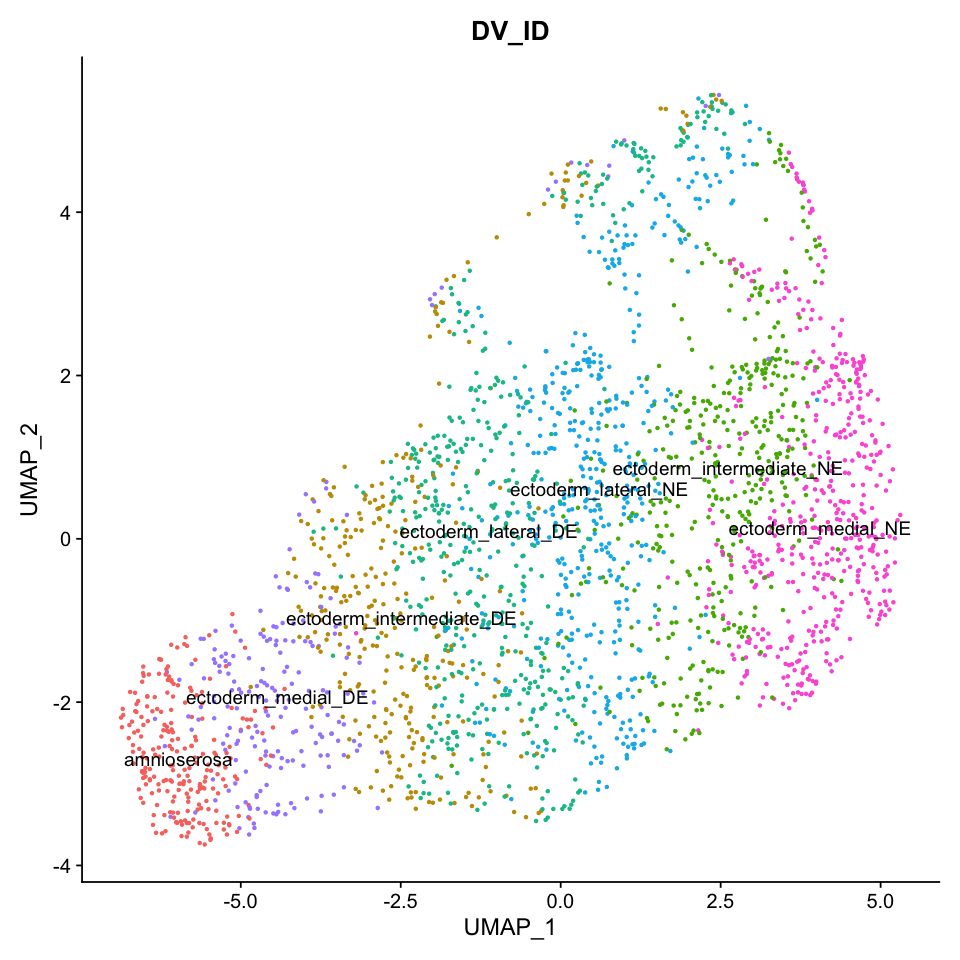

In [45]:
seu.ecto$DV_ID <- manual_id$manual_ID
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

In [46]:
levels <- read.table(file="./lateral_ect_DV_levels_color.txt")
colors <- levels[,2]
levels <- levels[,1]
head(levels)
length(levels)
head(colors)

[1] "ectoderm_medial_DE"       "ectoderm_intermediate_DE"
[3] "ectoderm_lateral_DE"      "ectoderm_lateral_NE"     
[5] "ectoderm_intermediate_NE" "ectoderm_medial_NE"

[1] 7

[1] "skyblue3"   "olivedrab2" "olivedrab4" "goldenrod3" "plum1"     
[6] "plum4"

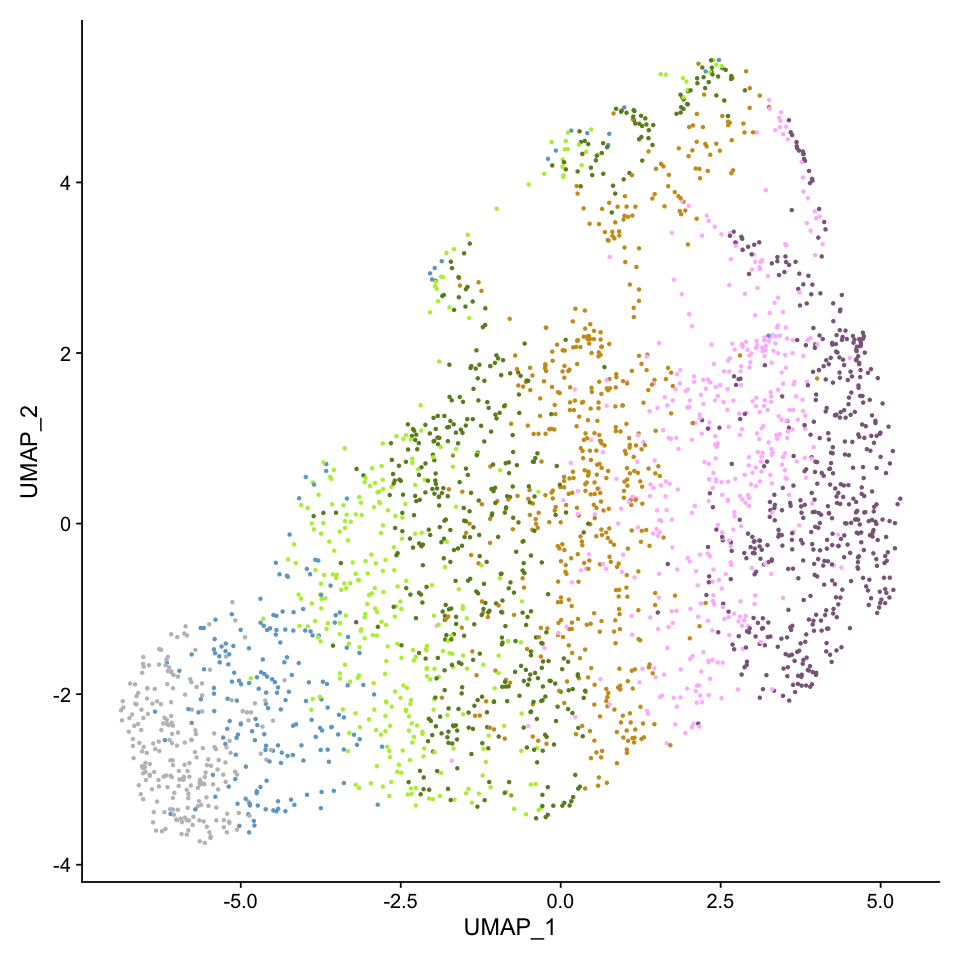

In [47]:
Idents(seu.ecto) <- 'DV_ID'
levels(seu.ecto) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE, cols = colors) + NoLegend() 
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_umap_DV_IDs.eps", dpi = 300, width =8, height = 8)

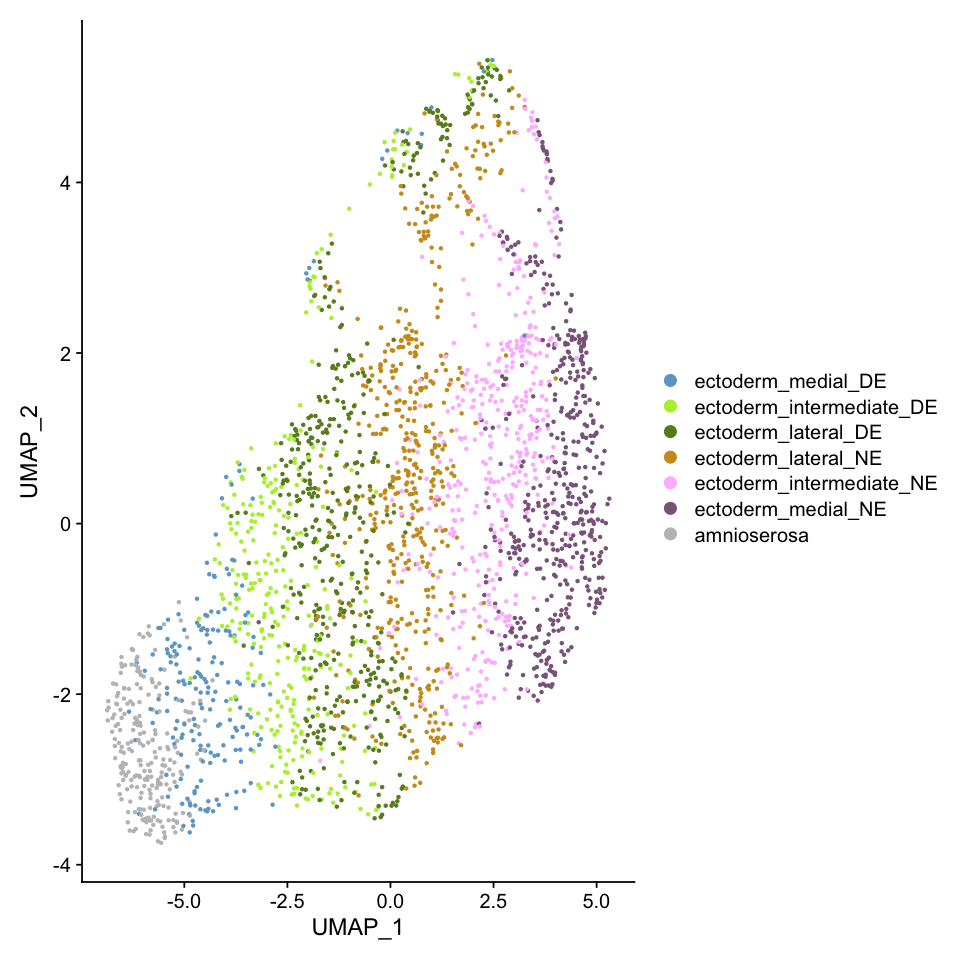

In [48]:
Idents(seu.ecto) <- 'DV_ID'
levels(seu.ecto) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE, cols = colors)
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_umap2_DV_IDs.eps", dpi = 300, width =8, height = 8)

## Merge AP and DV IDs

In [49]:
table(seu.ecto@meta.data[c('DV_ID','AP_ID')])

                          AP_ID
DV_ID                      abdominal abdominal_even abdominal_odd amnioserosa
  amnioserosa                      0              0             9         224
  ectoderm_intermediate_DE         5            143           140           1
  ectoderm_intermediate_NE       303             58            22           0
  ectoderm_lateral_DE             23            215           166           0
  ectoderm_lateral_NE            150            185            93           0
  ectoderm_medial_DE               4             30            82          75
  ectoderm_medial_NE             450              1             2           0
                          AP_ID
DV_ID                      PS2 PS1
  amnioserosa                0   0
  ectoderm_intermediate_DE  18  10
  ectoderm_intermediate_NE  26  19
  ectoderm_lateral_DE       44  30
  ectoderm_lateral_NE       47  29
  ectoderm_medial_DE         7   2
  ectoderm_medial_NE        24  17

Neuroectoderm cannot be split by even/odd. Also, there are some Dorsal ectoderm that cannot be assigned even/odd.

In [50]:
merged.id <- as.data.frame(paste(seu.ecto$DV_ID, seu.ecto$AP_ID,sep = '_'))
colnames(merged.id) <- c('manual_ID')
row.names(merged.id) <- colnames(seu.ecto)
head(merged.id)

,manual_ID
,<chr>
AAACCCATCCGTGTCT,ectoderm_intermediate_NE_abdominal
AAACGAAAGAATCGTA,ectoderm_medial_DE_amnioserosa
AAACGAAAGACTTCCA,amnioserosa_amnioserosa
AAACGAATCAAGCCTA,ectoderm_intermediate_DE_abdominal_odd
AAACGCTCACAGTATC,ectoderm_lateral_NE_abdominal_even
AAACGCTGTCGAACGA,amnioserosa_amnioserosa


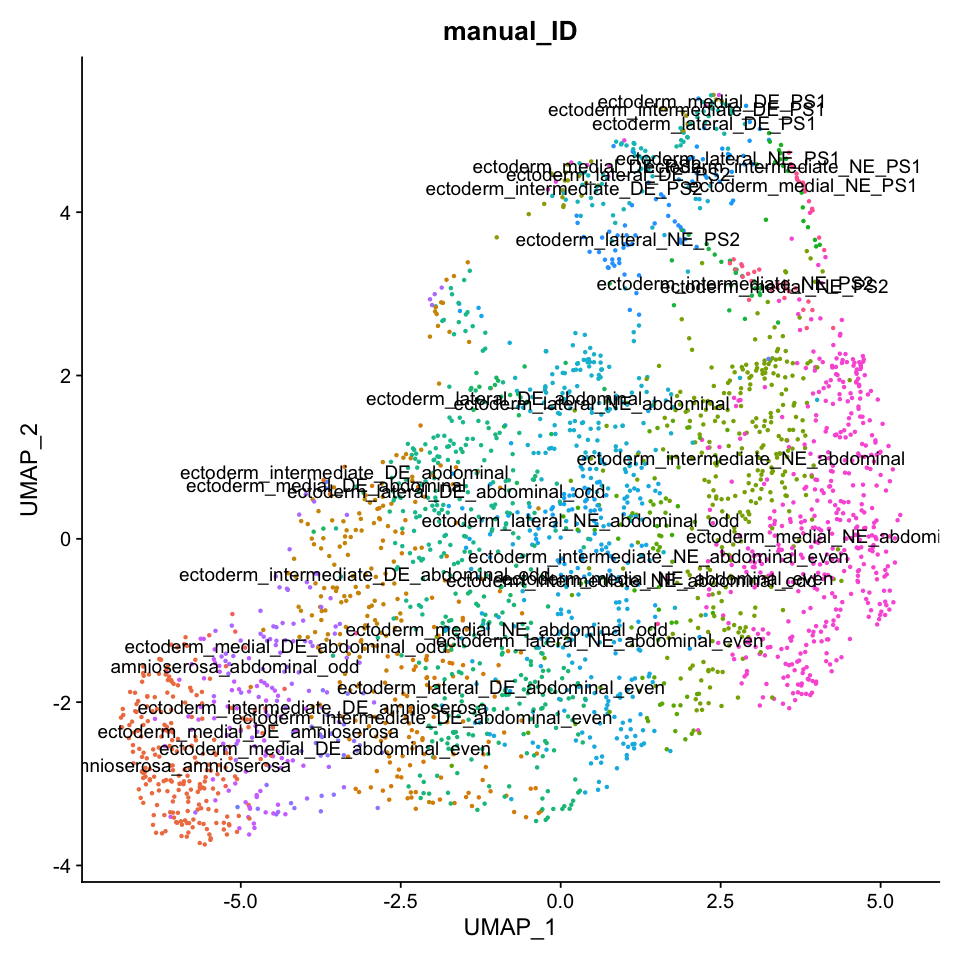

In [51]:
seu.ecto$manual_ID <- merged.id$manual_ID
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [52]:
unique(seu.ecto$manual_ID)

[1] "ectoderm_intermediate_NE_abdominal"     
 [2] "ectoderm_medial_DE_amnioserosa"         
 [3] "amnioserosa_amnioserosa"                
 [4] "ectoderm_intermediate_DE_abdominal_odd" 
 [5] "ectoderm_lateral_NE_abdominal_even"     
 [6] "ectoderm_medial_DE_abdominal_even"      
 [7] "ectoderm_lateral_DE_PS2"                
 [8] "ectoderm_lateral_NE_abdominal"          
 [9] "ectoderm_lateral_DE_abdominal_even"     
[10] "ectoderm_intermediate_DE_abdominal_even"
[11] "ectoderm_lateral_DE_PS1"                
[12] "ectoderm_medial_NE_abdominal"           
[13] "ectoderm_lateral_DE_abdominal_odd"      
[14] "ectoderm_lateral_DE_abdominal"          
[15] "ectoderm_lateral_NE_PS2"                
[16] "ectoderm_lateral_NE_abdominal_odd"      
[17] "ectoderm_intermediate_NE_abdominal_odd" 
[18] "ectoderm_lateral_NE_PS1"                
[19] "ectoderm_intermediate_DE_PS2"           
[20] "ectoderm_intermediate_NE_abdominal_even"
[21] "ectoderm_intermediate_NE_PS2"           
[22] "ectoderm_medial_DE_PS2"                 
[23] "ectoderm_medial_DE_abdominal_odd"       
[24] "ectoderm_intermediate_NE_PS1"           
[25] "ectoderm_medial_NE_PS1"                 
[26] "ectoderm_medial_NE_PS2"                 
[27] "ectoderm_medial_DE_abdominal"           
[28] "ectoderm_intermediate_DE_PS1"           
[29] "amnioserosa_abdominal_odd"              
[30] "ectoderm_medial_NE_abdominal_even"      
[31] "ectoderm_intermediate_DE_amnioserosa"   
[32] "ectoderm_intermediate_DE_abdominal"     
[33] "ectoderm_medial_DE_PS1"                 
[34] "ectoderm_medial_NE_abdominal_odd"

In [53]:
#amnioserosa cells on either of DV or AP annotation were assigned into 'amnioserosa_trunk'
merged.id$manual_ID <- gsub('amnioserosa_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('amnioserosa_abdominal_odd','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_medial_DE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_intermediate_DE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)

#Since even/odd annotation could not performed over the entire DV axis, 
#even and odd clusters were integrated.
merged.id$manual_ID <- gsub('abdominal_even','abdominal', merged.id$manual_ID)
merged.id$manual_ID <- gsub('abdominal_odd','abdominal', merged.id$manual_ID)

unique(merged.id$manual_ID)

[1] "ectoderm_intermediate_NE_abdominal" "amnioserosa_trunk"                 
 [3] "ectoderm_intermediate_DE_abdominal" "ectoderm_lateral_NE_abdominal"     
 [5] "ectoderm_medial_DE_abdominal"       "ectoderm_lateral_DE_PS2"           
 [7] "ectoderm_lateral_DE_abdominal"      "ectoderm_lateral_DE_PS1"           
 [9] "ectoderm_medial_NE_abdominal"       "ectoderm_lateral_NE_PS2"           
[11] "ectoderm_lateral_NE_PS1"            "ectoderm_intermediate_DE_PS2"      
[13] "ectoderm_intermediate_NE_PS2"       "ectoderm_medial_DE_PS2"            
[15] "ectoderm_intermediate_NE_PS1"       "ectoderm_medial_NE_PS1"            
[17] "ectoderm_medial_NE_PS2"             "ectoderm_intermediate_DE_PS1"      
[19] "ectoderm_medial_DE_PS1"

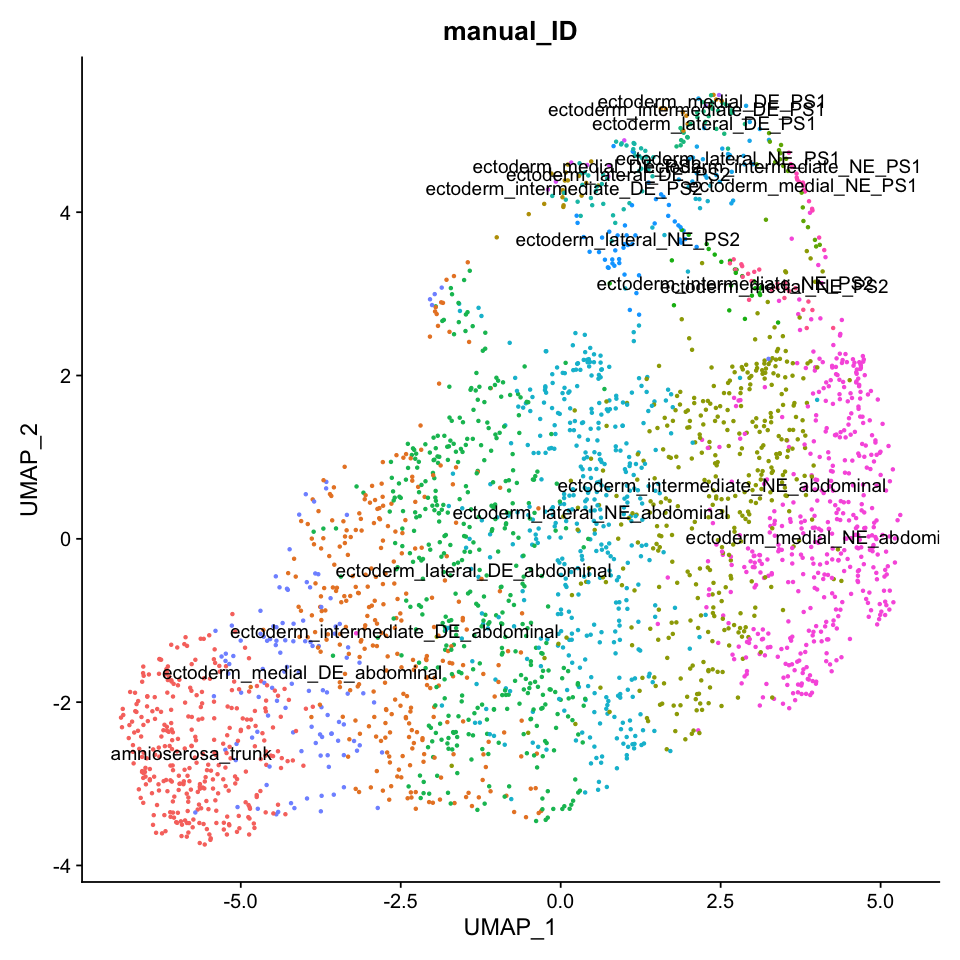

In [54]:
seu.ecto$manual_ID <- merged.id$manual_ID
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [55]:
Idents(seu.ecto) <- 'manual_ID'
levels(seu.ecto) <- c('ectoderm_medial_DE_PS1','ectoderm_intermediate_DE_PS1','ectoderm_lateral_DE_PS1',
                              'ectoderm_lateral_NE_PS1','ectoderm_intermediate_NE_PS1','ectoderm_medial_NE_PS1',
                               'ectoderm_medial_DE_PS2','ectoderm_intermediate_DE_PS2','ectoderm_lateral_DE_PS2',
                              'ectoderm_lateral_NE_PS2','ectoderm_intermediate_NE_PS2','ectoderm_medial_NE_PS2',
                               'ectoderm_medial_DE_abdominal','ectoderm_intermediate_DE_abdominal',
                               'ectoderm_lateral_DE_abdominal','ectoderm_lateral_NE_abdominal',
                               'ectoderm_intermediate_NE_abdominal','ectoderm_medial_NE_abdominal','amnioserosa_trunk'
                              )
all.markers.ecto <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers.ecto)
all.markers.ecto.top10 <- all.markers.ecto %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.ecto.top10)

Calculating cluster ectoderm_medial_DE_PS1

Calculating cluster ectoderm_intermediate_DE_PS1

Calculating cluster ectoderm_lateral_DE_PS1

Calculating cluster ectoderm_lateral_NE_PS1

Calculating cluster ectoderm_intermediate_NE_PS1

Calculating cluster ectoderm_medial_NE_PS1

Calculating cluster ectoderm_medial_DE_PS2

Calculating cluster ectoderm_intermediate_DE_PS2

Calculating cluster ectoderm_lateral_DE_PS2

Calculating cluster ectoderm_lateral_NE_PS2

Calculating cluster ectoderm_intermediate_NE_PS2

Calculating cluster ectoderm_medial_NE_PS2

Calculating cluster ectoderm_medial_DE_abdominal

Calculating cluster ectoderm_intermediate_DE_abdominal

Calculating cluster ectoderm_lateral_DE_abdominal

Calculating cluster ectoderm_lateral_NE_abdominal

Calculating cluster ectoderm_intermediate_NE_abdominal

Calculating cluster ectoderm_medial_NE_abdominal

Calculating cluster amnioserosa_trunk



[1] 1385

[1] 180

Saving 7 x 7 in image



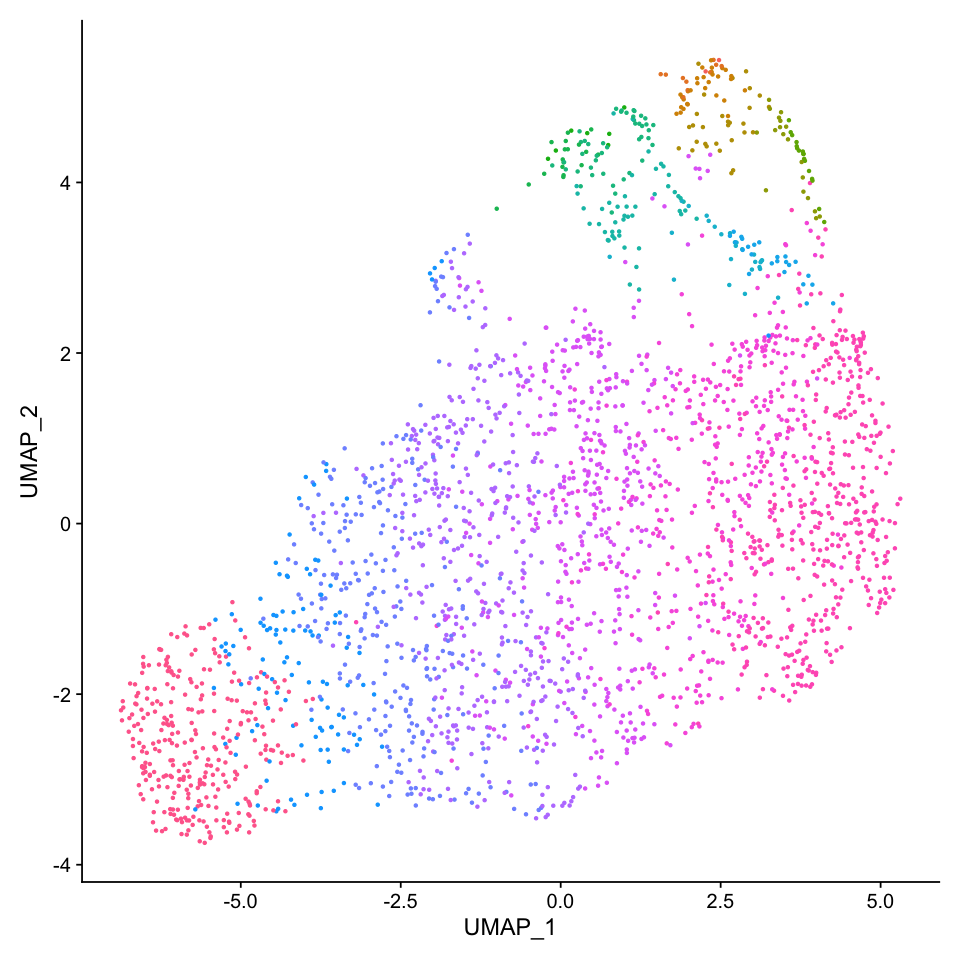

In [56]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE) + NoLegend() 
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ect_umap1.eps", dpi = 300)

Saving 7 x 7 in image



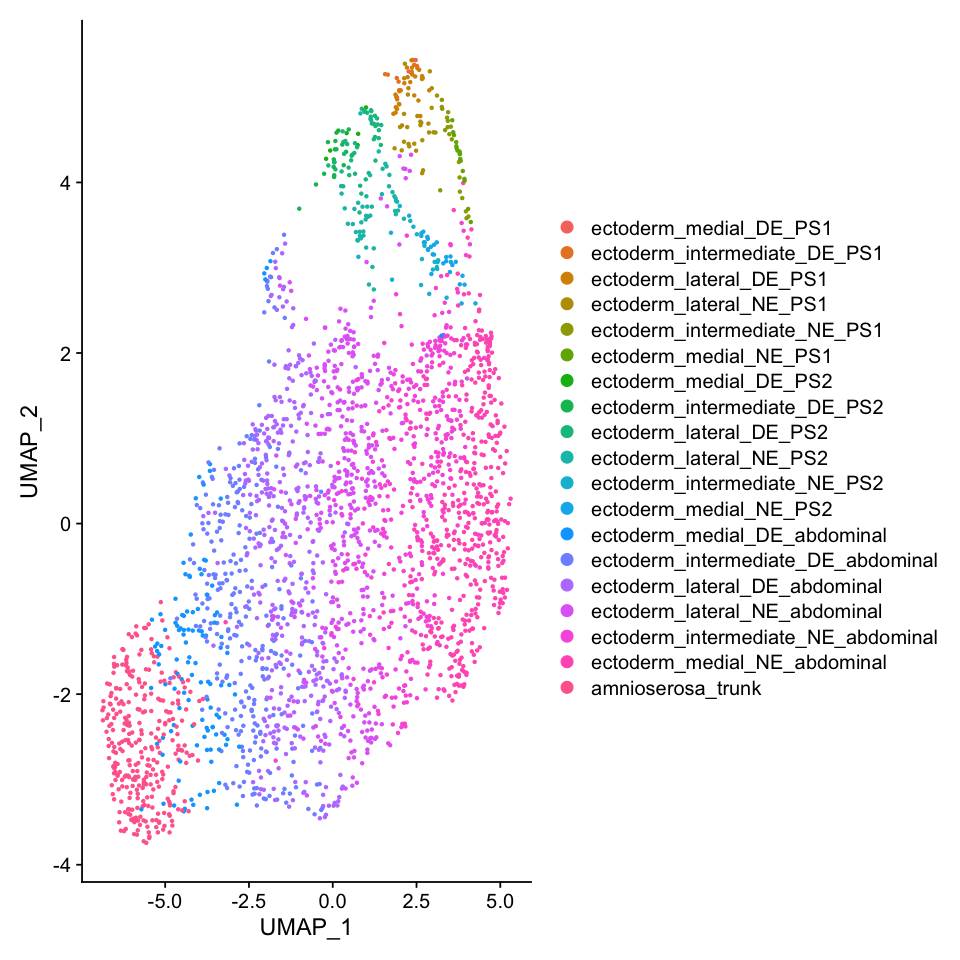

In [57]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE)
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ect_umap2.eps", dpi = 300)

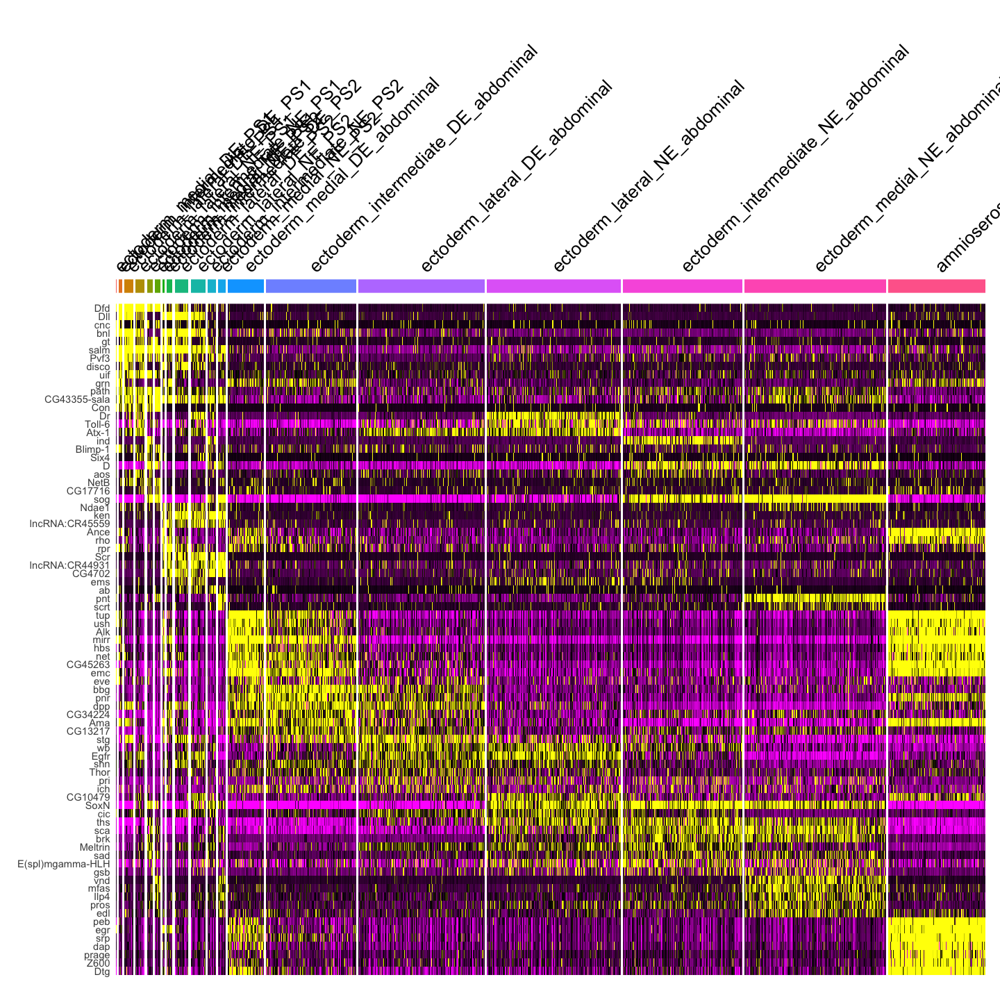

In [58]:
options(repr.plot.width=12, repr.plot.height=12)
fig <- DoHeatmap(seu.ecto, features = c(all.markers.ecto.top10$gene)) + NoLegend()
fig
ggsave(fig, file = "./figures/04_lateral_ecto_subclutering_Set2/lateral_ecto_manualID_heatmap.eps", dpi = 300,  width = 12, height = 12)

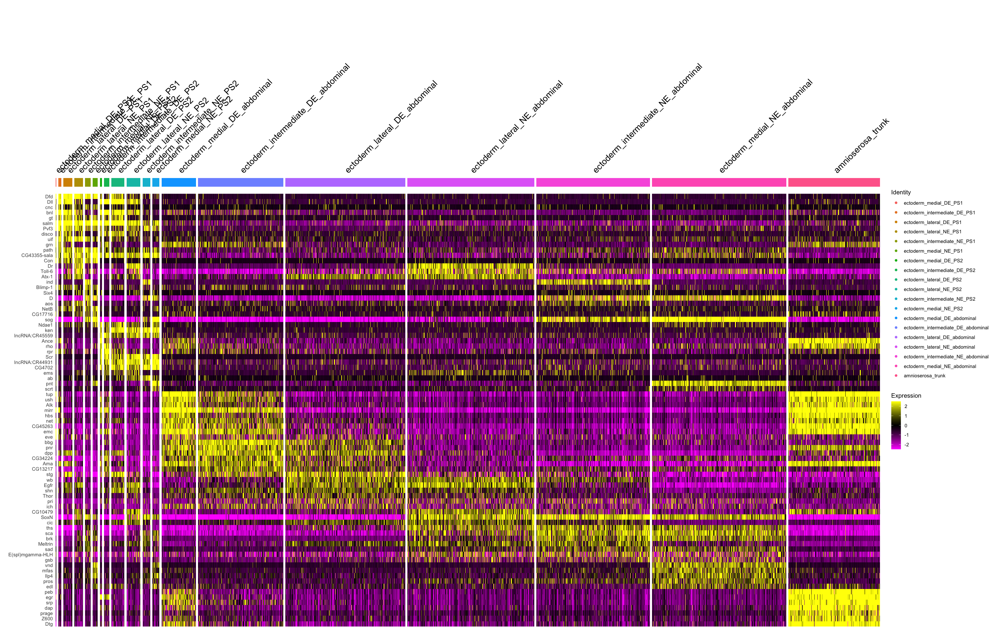

In [59]:
options(repr.plot.width=25, repr.plot.height=16)
DoHeatmap(seu.ecto, features = c(all.markers.ecto.top10$gene))

In [60]:
saveRDS(object = seu.ecto, file = '../../data/seurat_object/Set2/subclustering/seu_lateral_ecto_subclustered.obj')

In [61]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-apple-darwin17.0 (64-bit)
Running under: macOS Catalina 10.15.7

Matrix products: default
BLAS:   /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRblas.dylib
LAPACK: /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRlapack.dylib

locale:
[1] ja_JP.UTF-8/ja_JP.UTF-8/ja_JP.UTF-8/C/ja_JP.UTF-8/ja_JP.UTF-8

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
[1] tibble_3.0.5      dplyr_1.0.3       Matrix_1.3-2      data.table_1.13.6
[5] magrittr_2.0.1    ggplot2_3.3.3     Seurat_3.2.3     

loaded via a namespace (and not attached):
  [1] nlme_3.1-151          matrixStats_0.57.0    RcppAnnoy_0.0.18     
  [4] RColorBrewer_1.1-2    httr_1.4.2            repr_1.1.0           
  [7] sctransform_0.3.2     tools_4.0.3           R6_2.5.1             
 [10] irlba_2.3.3           rpart_4.1-15          KernSmooth_2.23-18   
 [13] uwot_0.1.10           mgcv